# ***``T-Distributed Stochastic Neighbor Embedding``***

---

## 1. [t-SNE on boundary values](#t-SNE_on_boundary_values)
- #### [CASE-I](#Boundary:CASE-I)
- #### [CASE-II](#Boundary:CASE-II)
- #### [CASE-III](#Boundary:CASE-III)

## 2. [Multiple runs of t-SNE on range of perplexities and iterations](#Multiple_runs)
- #### [CASE-I](#CASE-I-Multiple_runs)
- #### [CASE-II](#CASE-II-Multiple_runs)
- #### [CASE-III](#CASE-III-Multiple_runs)
    
## 3. [t-SNE on Iris Dataset](#IRIS_Dataset)
- #### [CASE-I](#IRIS:CASE-I-Multiple_runs)
- #### [CASE-II](#IRIS:CASE-II-Multiple_runs)
- #### [CASE-III](#IRIS:CASE-III-Multiple_runs)
- #### [Results from Multiple Runs](#IRIS:Result_of_multiple_runs)
- #### [t-SNE with 'pca' embedding](#Other_method)

## 4. [Conclusion](#Conclusion)

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.datasets import load_breast_cancer as bc, load_iris as l_iris
from sklearn.preprocessing import StandardScaler as SS
from sklearn.manifold import TSNE

%matplotlib inline

In [2]:
cancer = bc()                                  ## Instantiating Breast Cancer Dataset object
iris = l_iris()                                ## Instantiating IRIS Datset object
ss = SS()                                      ## Instantiating Standard Scaler
tsne = TSNE(n_components=2, random_state=41)   ## Instantiating TSNE

In [3]:
cancer_df = pd.concat([pd.DataFrame(cancer.data,columns=cancer.feature_names),pd.DataFrame(cancer.target,columns=['target'])],axis=1)
cancer_norm_df = pd.DataFrame(ss.fit_transform(cancer_df.iloc[:,0:-1]),columns=cancer.feature_names)
cancer_norm_df.head(10)

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,1.097064,-2.073335,1.269934,0.984375,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747,...,1.886690,-1.359293,2.303601,2.001237,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015
1,1.829821,-0.353632,1.685955,1.908708,-0.826962,-0.487072,-0.023846,0.548144,0.001392,-0.868652,...,1.805927,-0.369203,1.535126,1.890489,-0.375612,-0.430444,-0.146749,1.087084,-0.243890,0.281190
2,1.579888,0.456187,1.566503,1.558884,0.942210,1.052926,1.363478,2.037231,0.939685,-0.398008,...,1.511870,-0.023974,1.347475,1.456285,0.527407,1.082932,0.854974,1.955000,1.152255,0.201391
3,-0.768909,0.253732,-0.592687,-0.764464,3.283553,3.402909,1.915897,1.451707,2.867383,4.910919,...,-0.281464,0.133984,-0.249939,-0.550021,3.394275,3.893397,1.989588,2.175786,6.046041,4.935010
4,1.750297,-1.151816,1.776573,1.826229,0.280372,0.539340,1.371011,1.428493,-0.009560,-0.562450,...,1.298575,-1.466770,1.338539,1.220724,0.220556,-0.313395,0.613179,0.729259,-0.868353,-0.397100
5,-0.476375,-0.835335,-0.387148,-0.505650,2.237421,1.244335,0.866302,0.824656,1.005402,1.890005,...,-0.165498,-0.313836,-0.115009,-0.244320,2.048513,1.721616,1.263243,0.905888,1.754069,2.241802
6,1.170908,0.160649,1.138125,1.095295,-0.123136,0.088295,0.300072,0.646935,-0.064325,-0.762332,...,1.368983,0.322883,1.368325,1.275220,0.518640,0.021215,0.509552,1.196716,0.262476,-0.014730
7,-0.118517,0.358450,-0.072867,-0.218965,1.604049,1.140102,0.061026,0.281950,1.403355,1.660353,...,0.163763,0.401048,0.099449,0.028859,1.447961,0.724786,-0.021054,0.624196,0.477640,1.726435
8,-0.320167,0.588830,-0.184080,-0.384207,2.201839,1.684010,1.219096,1.150692,1.965600,1.572462,...,-0.161357,0.822813,-0.031609,-0.248363,1.662757,1.818310,1.280035,1.391616,2.389857,1.288650
9,-0.473535,1.105439,-0.329482,-0.509063,1.582699,2.563358,1.738872,0.941760,0.797298,2.783096,...,-0.244190,2.443109,-0.286278,-0.297409,2.320295,5.112877,3.995433,1.620015,2.370444,6.846856


In [4]:
cancer_df['target'].value_counts()

1    357
0    212
Name: target, dtype: int64

# ***`t-SNE_on_boundary_values`***

## ***`Boundary:CASE-I`***
- ### ***`Lowest boundary value of Perplexity as 1 on different Iterations`***

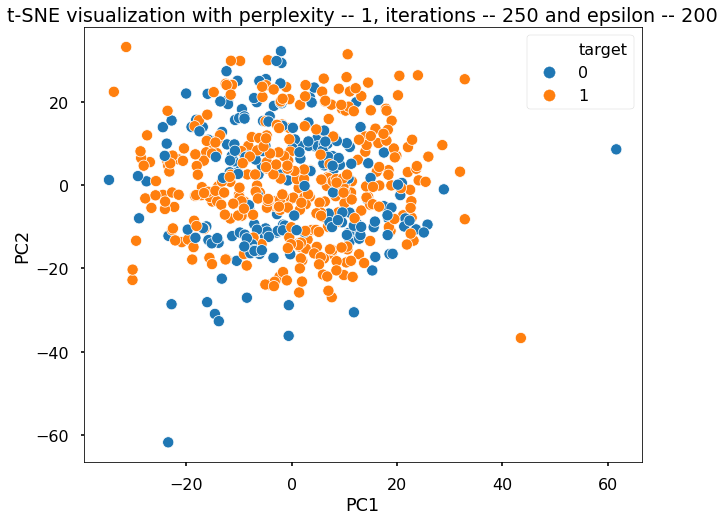

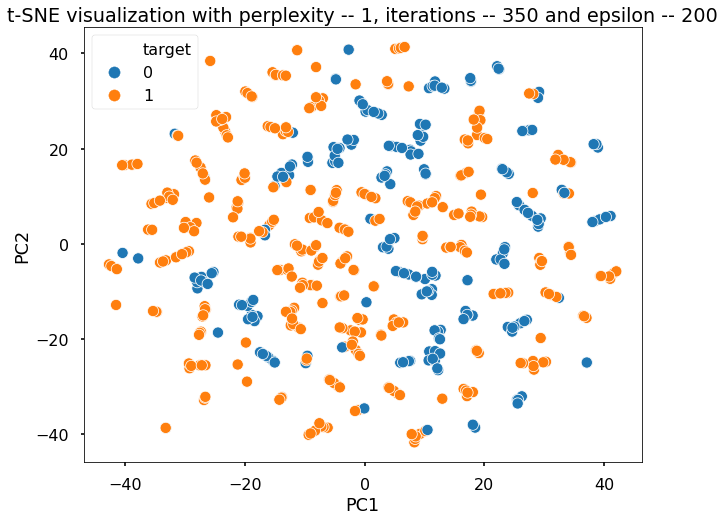

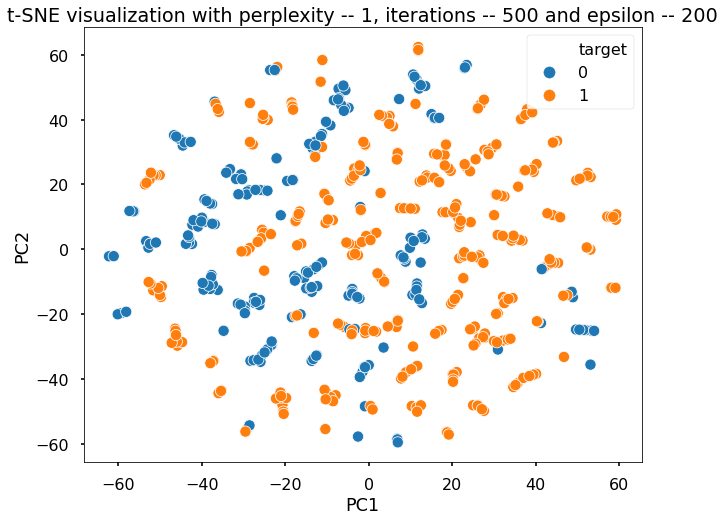

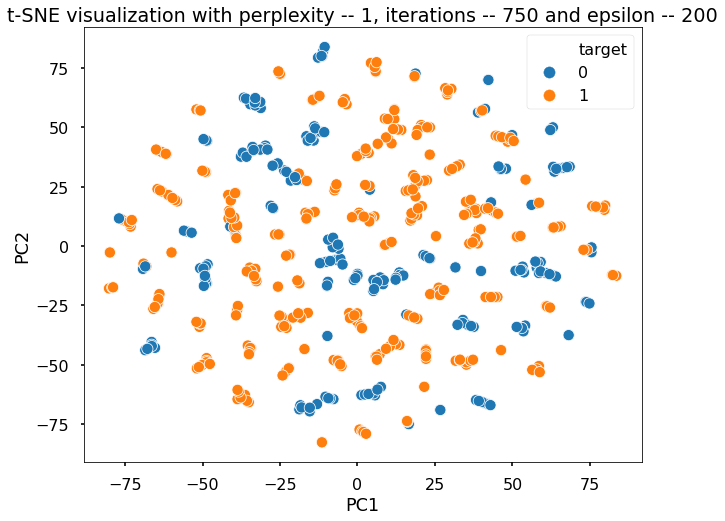

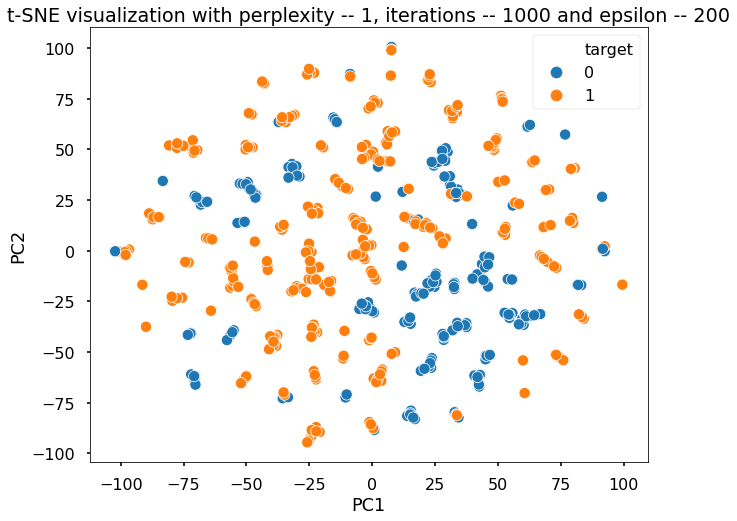

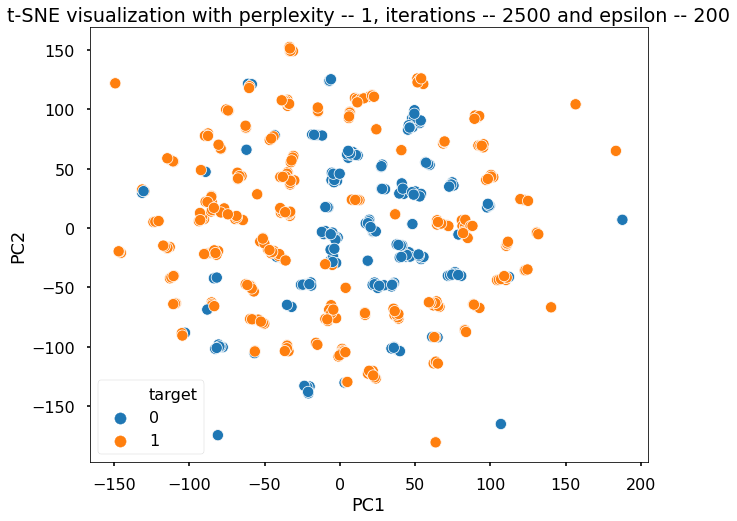

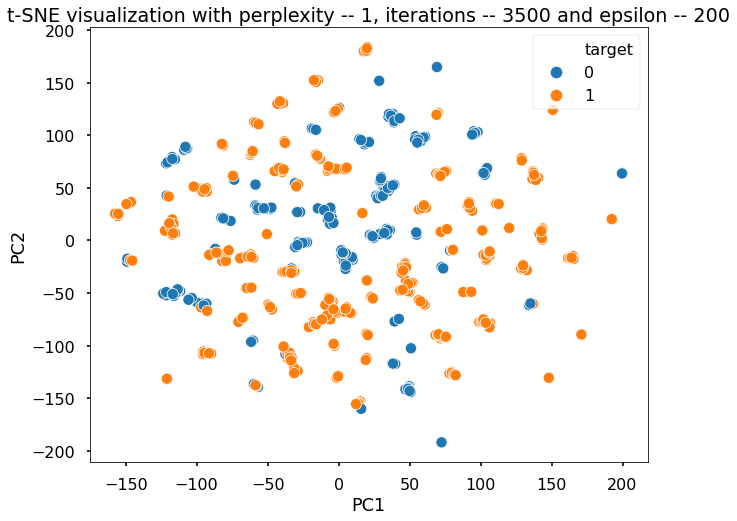

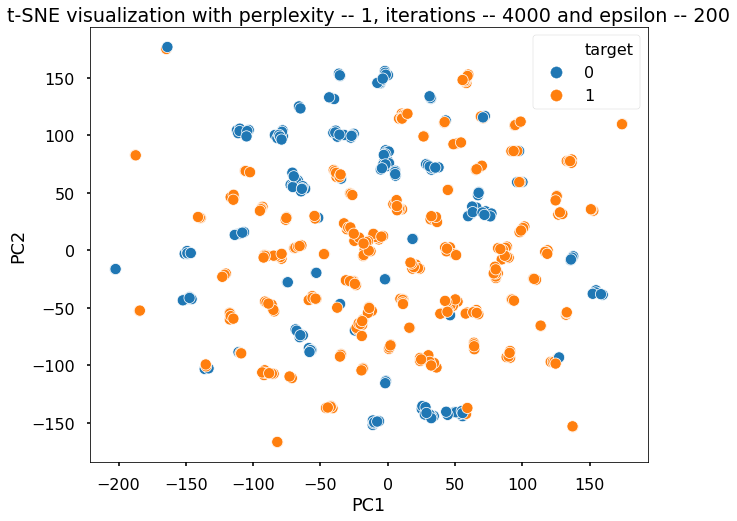

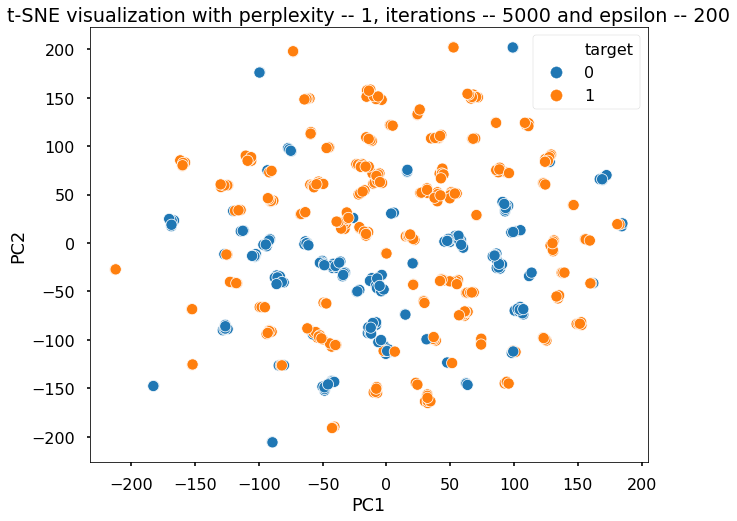

In [83]:
iterations = [250,350,500,750,1000,2500,3500,4000,5000]

for idx in range(len(iterations)):
    tsne1 = TSNE(n_components=2,perplexity=1,learning_rate=200,n_iter=iterations[idx])
    cancer_tsne_pcmps = pd.DataFrame(tsne1.fit_transform(cancer_norm_df),columns=['PC1','PC2'])
    cancer_tsne_pcmps = pd.concat([cancer_tsne_pcmps,cancer_df['target']],axis=1)
    with plt.style.context('seaborn-poster'):
        plt.figure(figsize=(7,7))
        sns.scatterplot(data=cancer_tsne_pcmps,x='PC1',y='PC2',hue='target')
        plt.title("t-SNE visualization with perplexity -- {0}, iterations -- {1} and epsilon -- {2}".format(tsne1.perplexity,
                                                                                                            tsne1.n_iter,
                                                                                                            tsne1.learning_rate))
        plt.show()

### **With the lowest value of Perplexity as 1 and Learning rate(Epsilon) slightly on a higher side as 200, we got the small random clusters of both the classes.**

## ***`Boundary:CASE-II`***
- ### ***`Highest boundary value of Perplexity as 569(number of data points) with Epsilon as low as 20 on different Iterations`***

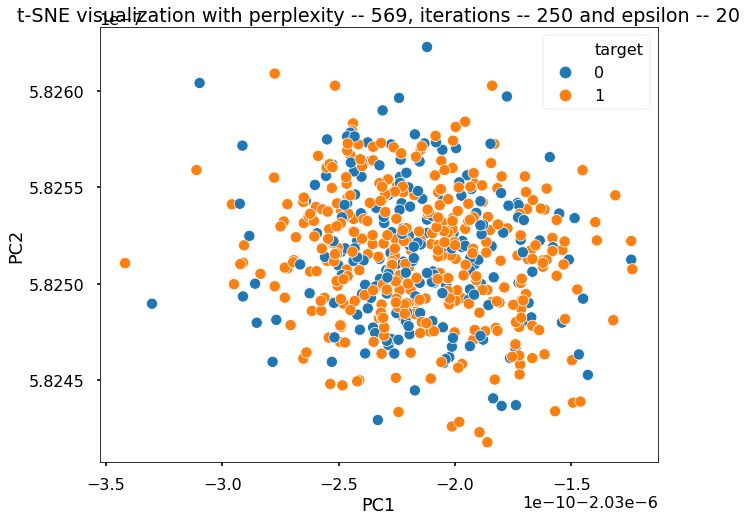

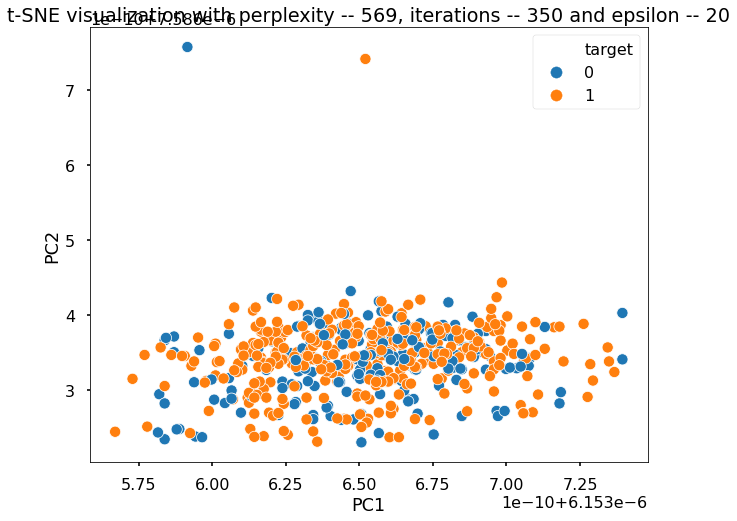

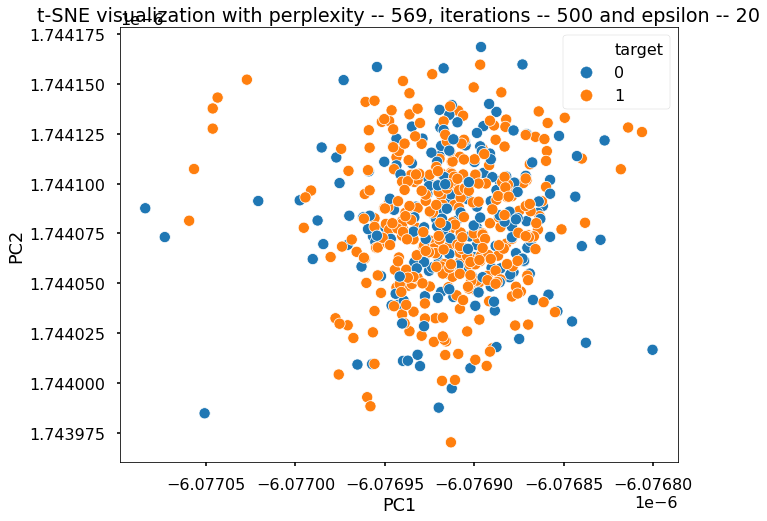

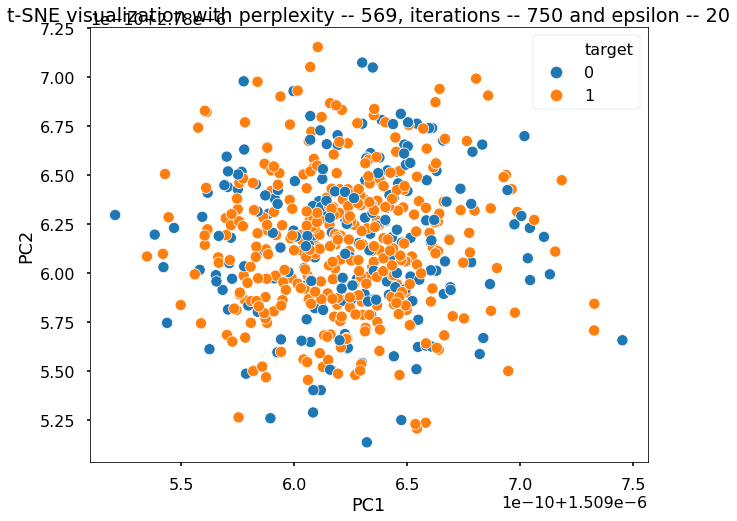

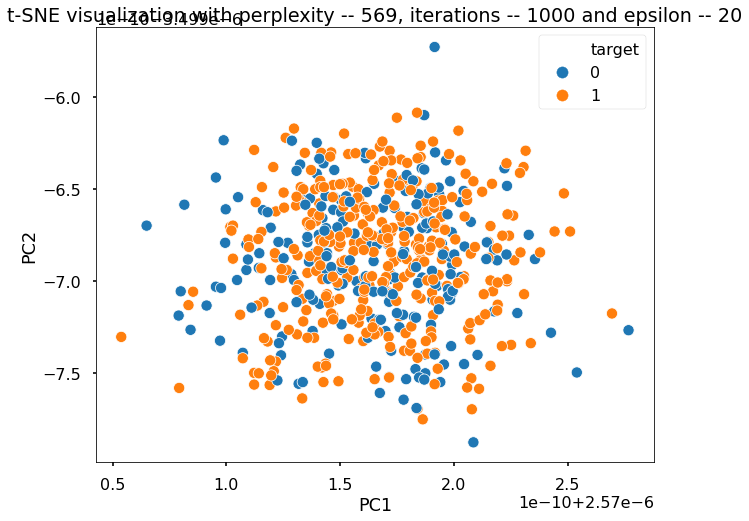

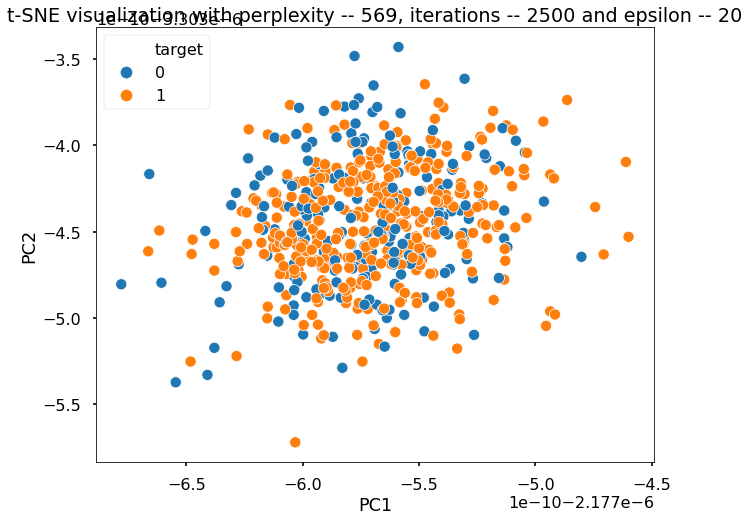

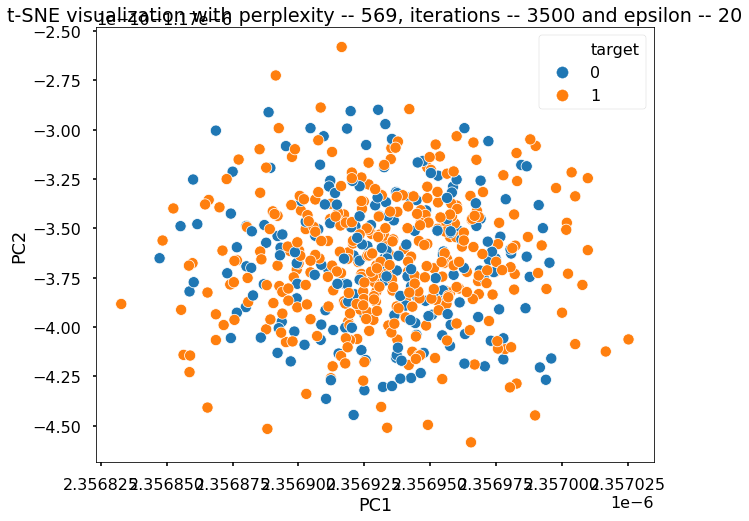

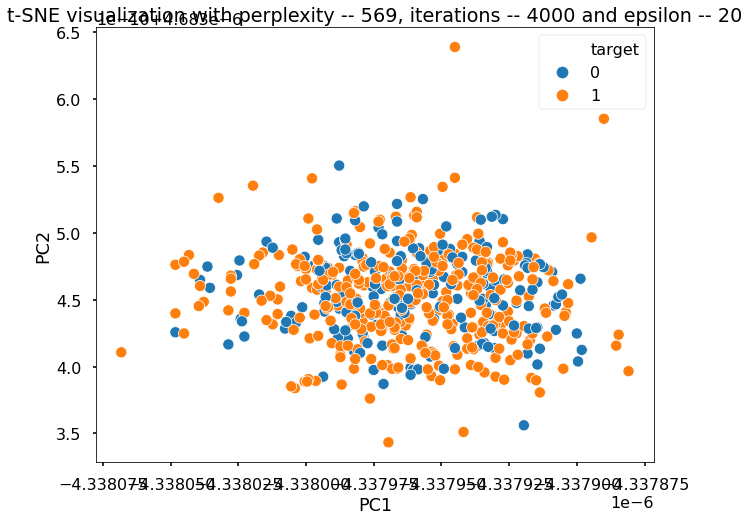

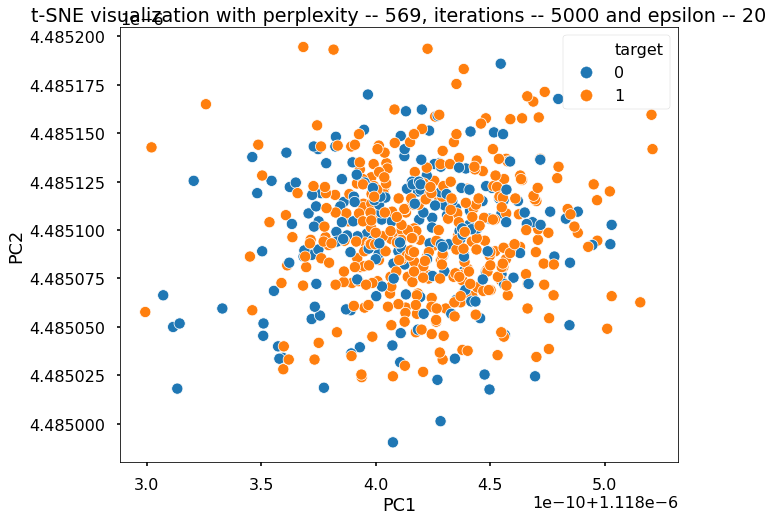

In [5]:
iterations = [250,350,500,750,1000,2500,3500,4000,5000]

for idx in range(len(iterations)):
    tsne1 = TSNE(n_components=2,perplexity=569,learning_rate=20,n_iter=iterations[idx])
    cancer_tsne_pcmps = pd.DataFrame(tsne1.fit_transform(cancer_norm_df),columns=['PC1','PC2'])
    cancer_tsne_pcmps = pd.concat([cancer_tsne_pcmps,cancer_df['target']],axis=1)
    with plt.style.context('seaborn-poster'):
        plt.figure(figsize=(10,8))
        sns.scatterplot(data=cancer_tsne_pcmps,x='PC1',y='PC2',hue='target')
        plt.title("t-SNE visualization with perplexity -- {0}, iterations -- {1} and epsilon -- {2}".format(tsne1.perplexity,
                                                                                                            tsne1.n_iter,
                                                                                                            tsne1.learning_rate))
        plt.show()

### **With the highest value of Perplexity as 569 and Learning rate(Epsilon) on a lower side as 20, we got the completely random data as a Noise.**

## ***`Boundary:CASE-III`***
- ### ***`Highest boundary value of Perplexity as 569(number of data points) with Epsilon as high as 300 on different Iterations`***

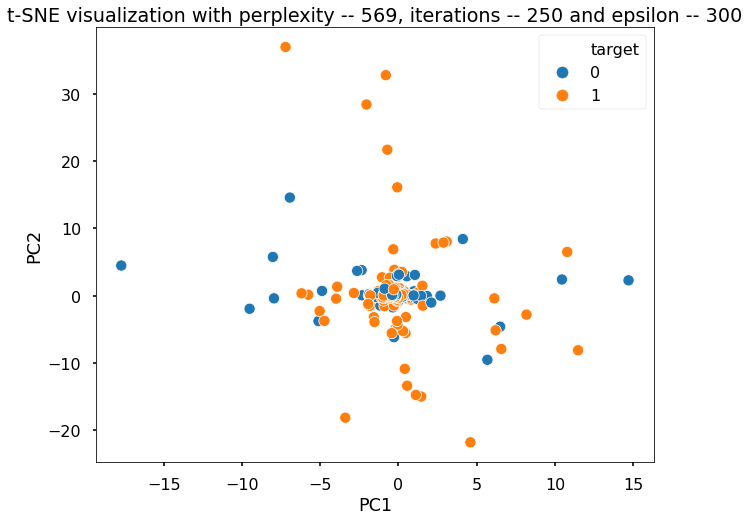

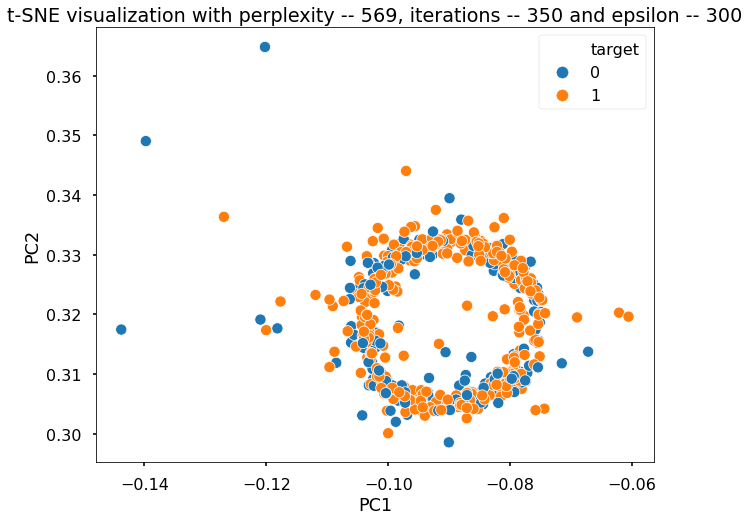

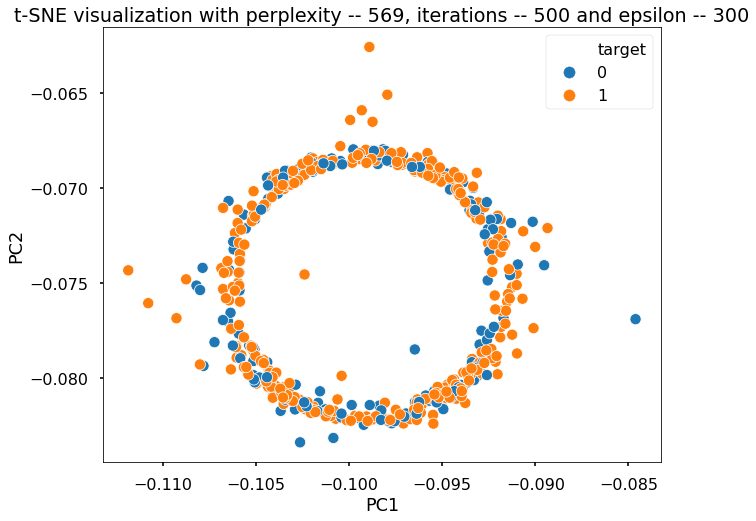

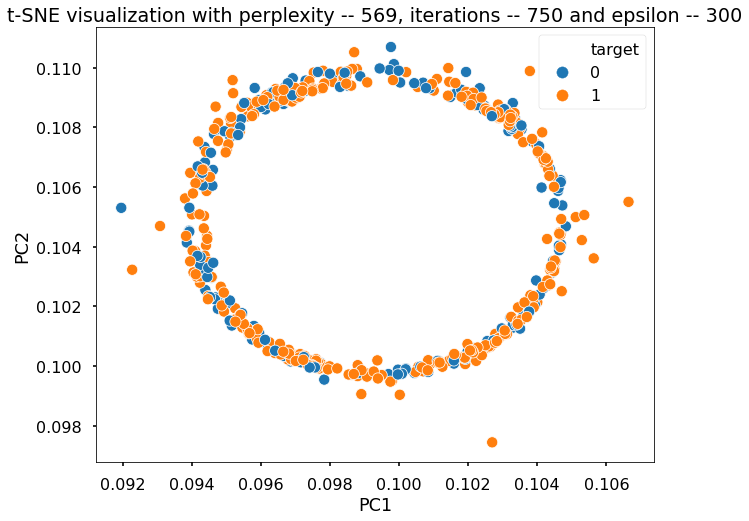

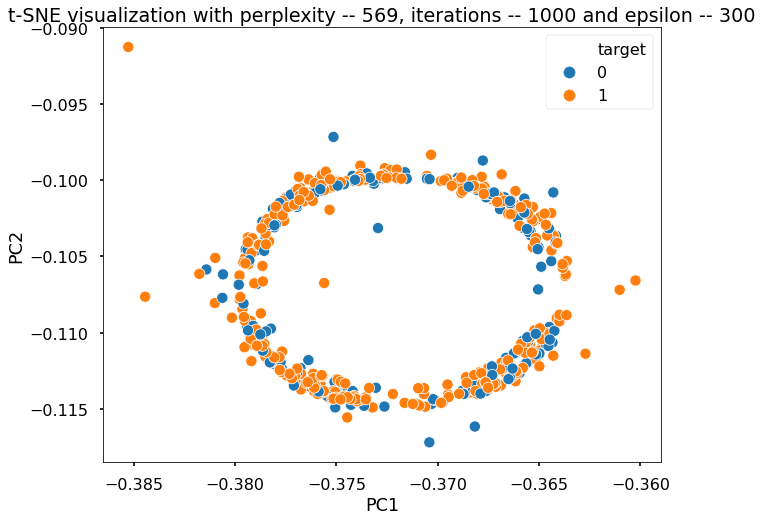

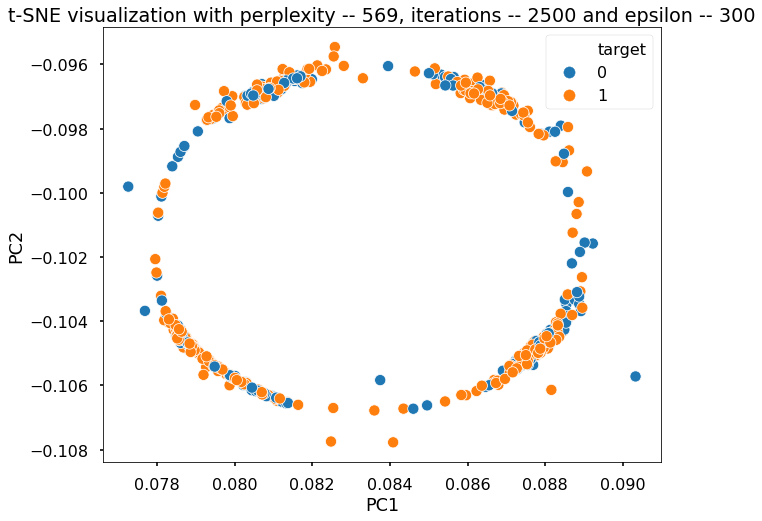

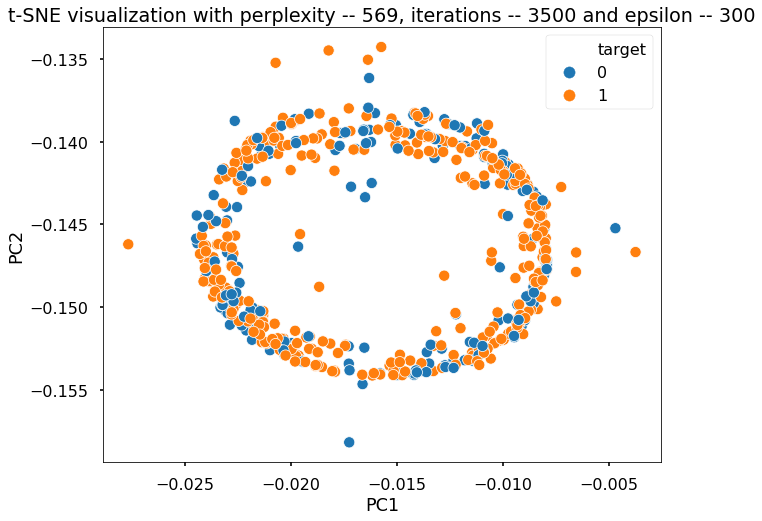

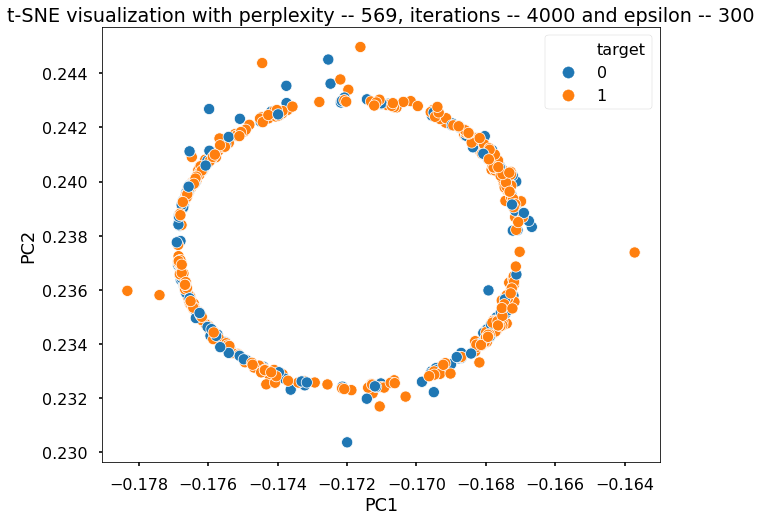

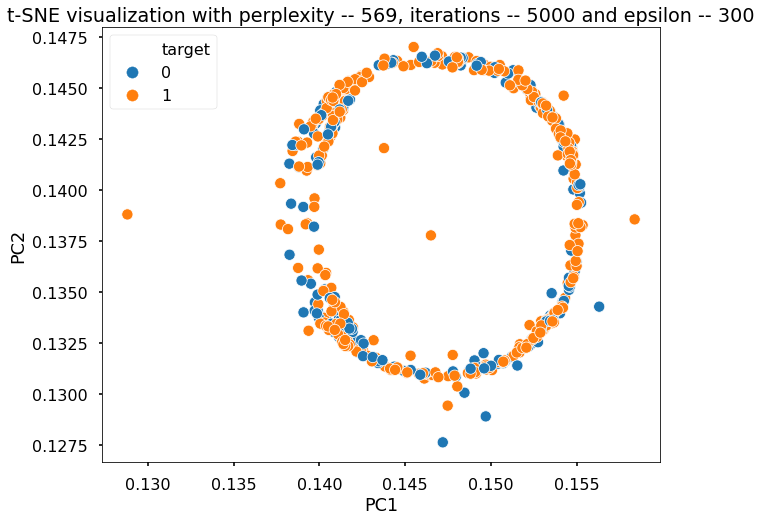

In [6]:
iterations = [250,350,500,750,1000,2500,3500,4000,5000]

for idx in range(len(iterations)):
    tsne1 = TSNE(n_components=2,perplexity=569,learning_rate=300,n_iter=iterations[idx])
    cancer_tsne_pcmps = pd.DataFrame(tsne1.fit_transform(cancer_norm_df),columns=['PC1','PC2'])
    cancer_tsne_pcmps = pd.concat([cancer_tsne_pcmps,cancer_df['target']],axis=1)
    with plt.style.context('seaborn-poster'):
        plt.figure(figsize=(10,8))
        sns.scatterplot(data=cancer_tsne_pcmps,x='PC1',y='PC2',hue='target')
        plt.title("t-SNE visualization with perplexity -- {0}, iterations -- {1} and epsilon -- {2}".format(tsne1.perplexity,
                                                                                                            tsne1.n_iter,
                                                                                                            tsne1.learning_rate))
        plt.show()

### **With the highest value of Perplexity as 569 and Learning rate(Epsilon) on a higher side as 300, we got the ball shaped data cluster which says that every point is a definite distance away from each other.**

## ***`Multiple_runs`***

## ***`CASE-I-Multiple_runs`***
### ***`Running t-SNE on a range of perplexities, iterations and learning rates with embedding initialization as 'random'`***

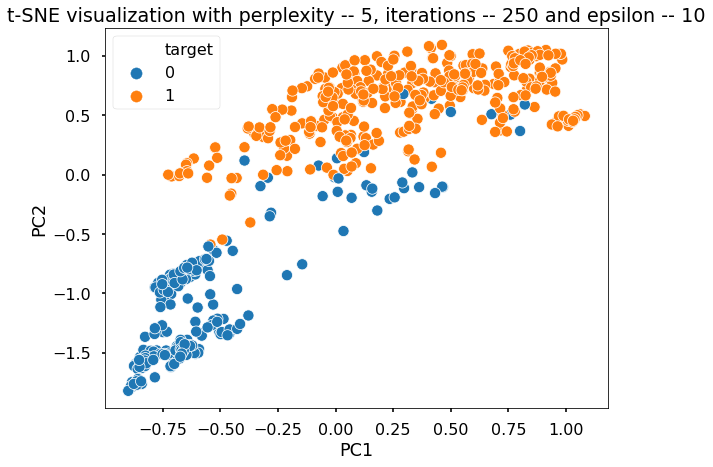

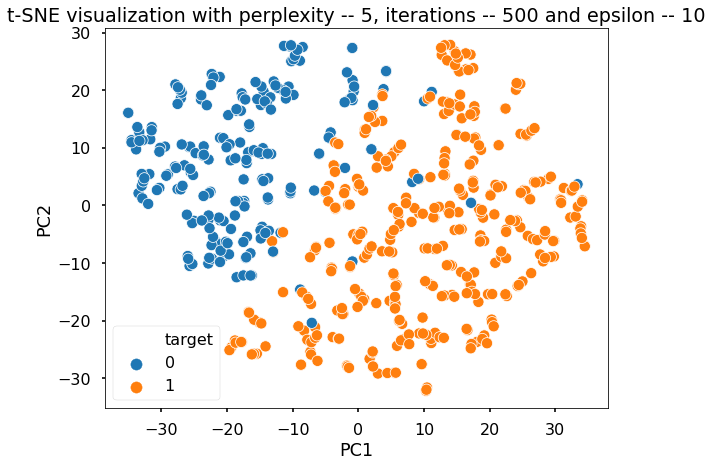

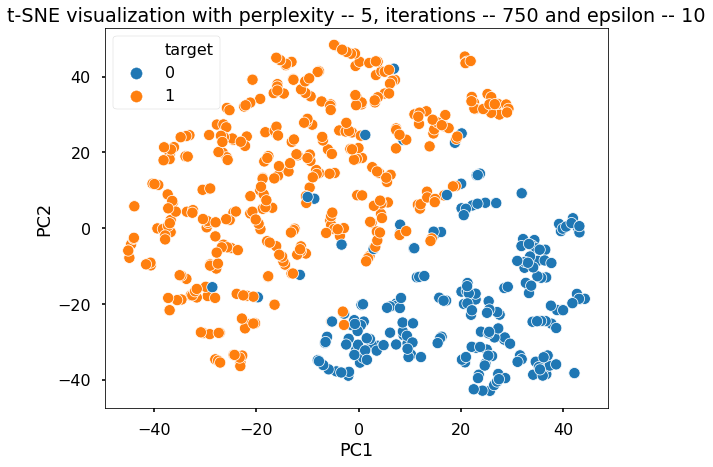

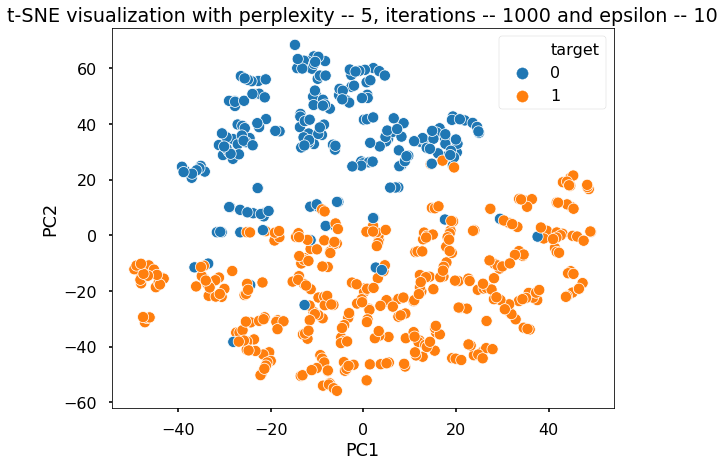

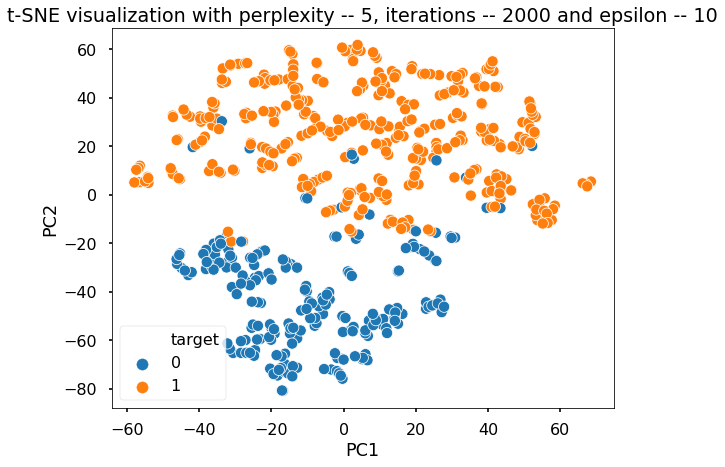

...

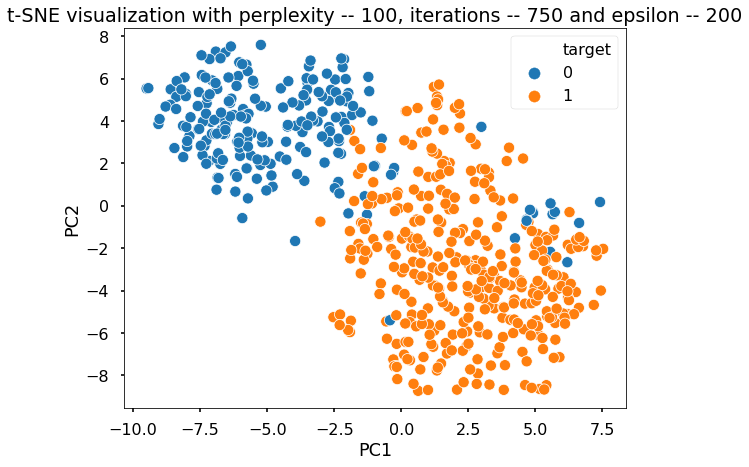

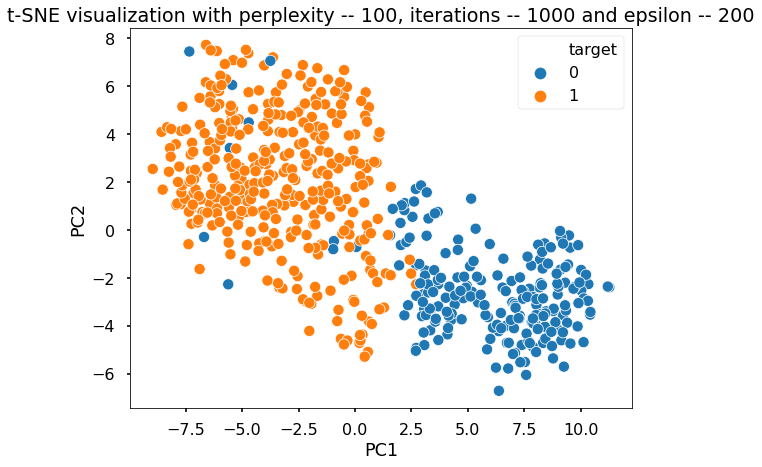

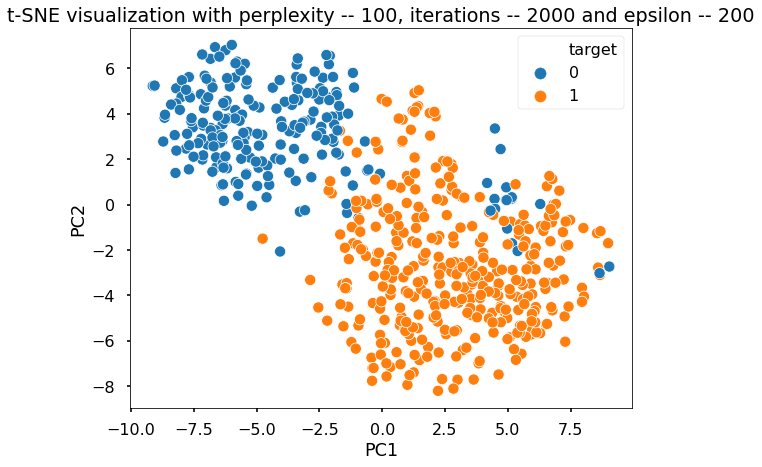

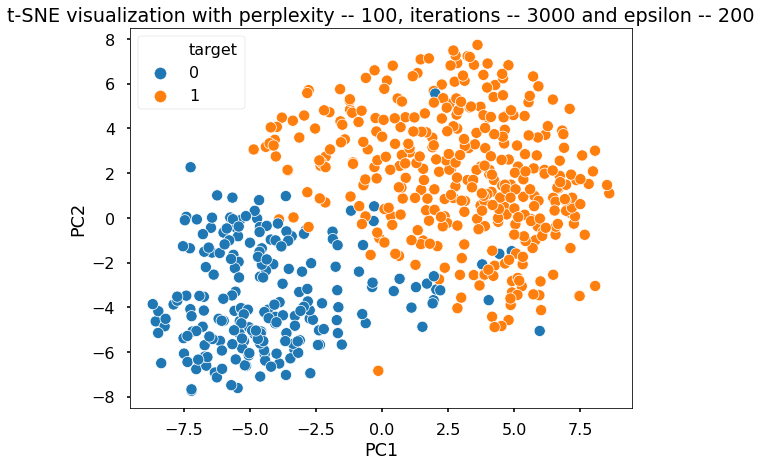

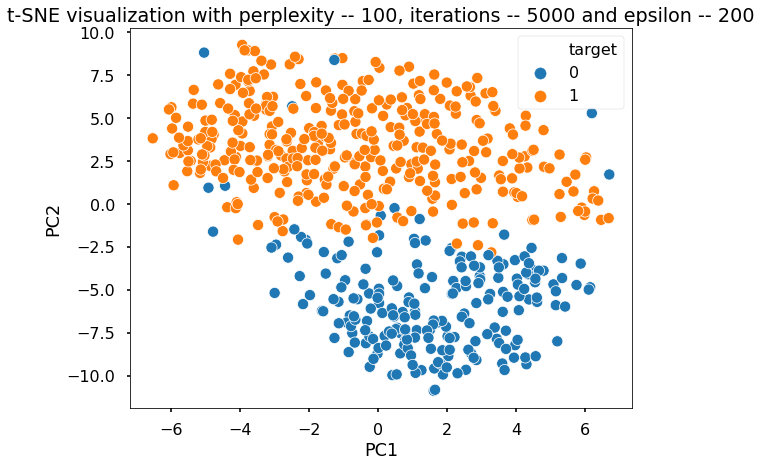

In [8]:
perplexities = [30,50,100]
iterations = [250,500,750,1000,3000,5000]
l_rate = [10,30,50,100,200]

for pidx in range(len(perplexities)):
    for lidx in range(len(l_rate)):
        for idx in range(len(iterations)):
            tsne1 = TSNE(n_components=2,init='random',perplexity=perplexities[pidx],learning_rate=l_rate[lidx],n_iter=iterations[idx],
                        n_jobs=-1)
            cancer_tsne_pcmps = pd.DataFrame(tsne1.fit_transform(cancer_norm_df),columns=['PC1','PC2'])
            cancer_tsne_pcmps = pd.concat([cancer_tsne_pcmps,cancer_df['target']],axis=1)
            with plt.style.context('seaborn-poster'):
                plt.figure(figsize=(9,7))
                sns.scatterplot(data=cancer_tsne_pcmps,x='PC1',y='PC2',hue='target')
                plt.title("t-SNE visualization with perplexity -- {0}, iterations -- {1} and epsilon -- {2}".format(tsne1.perplexity,
                                                                                                            tsne1.n_iter,
                                                                                                            tsne1.learning_rate))
                plt.show()

### **In the above plots, my obervation is that with Perplexity=30 and Epsilon=30 gives us the better separation of classes with a very few outliers. However, in the other plots the outliers are quite high and they are largely distant from the respective class cluster.**

### **So, next step is to run the T-SNE for this combination multiple times with various iterations.**

## ***`CASE-II-Multiple_runs`***
### ***`Running t-SNE for a range of iterations with learning rate and perplexity as 30 and embedding method as 'random'`***

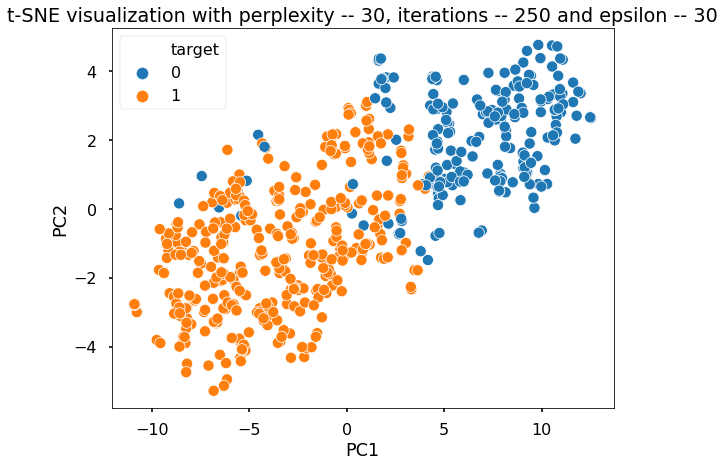

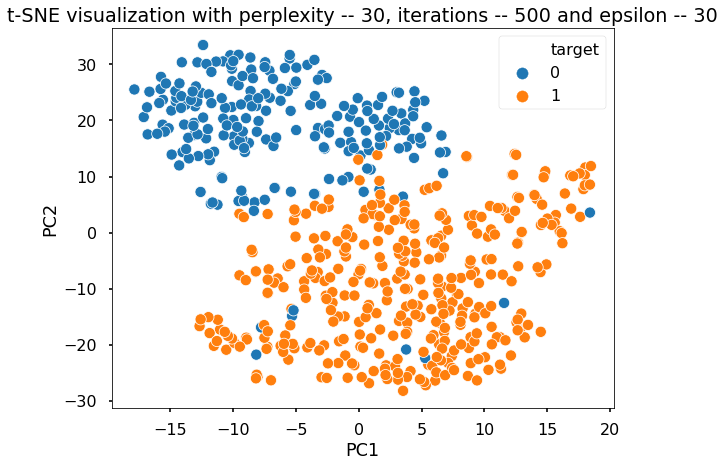

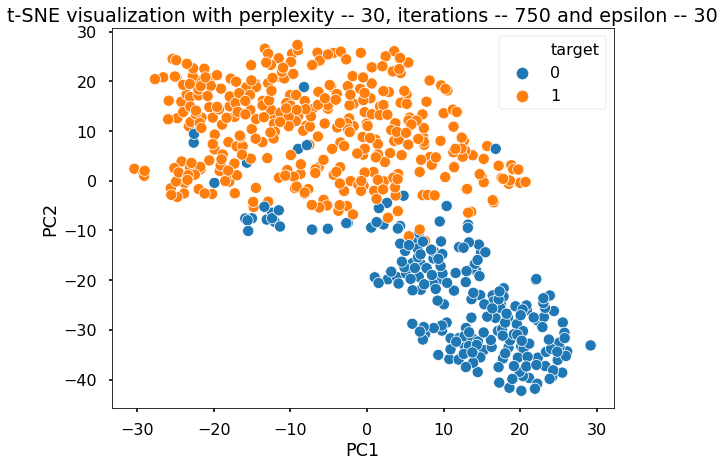

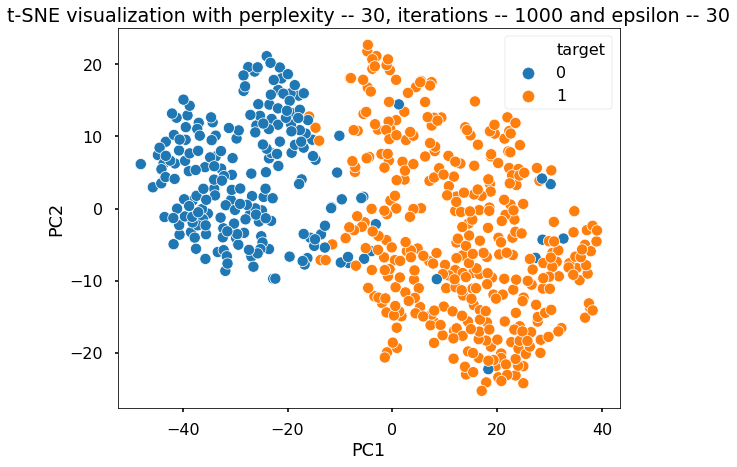

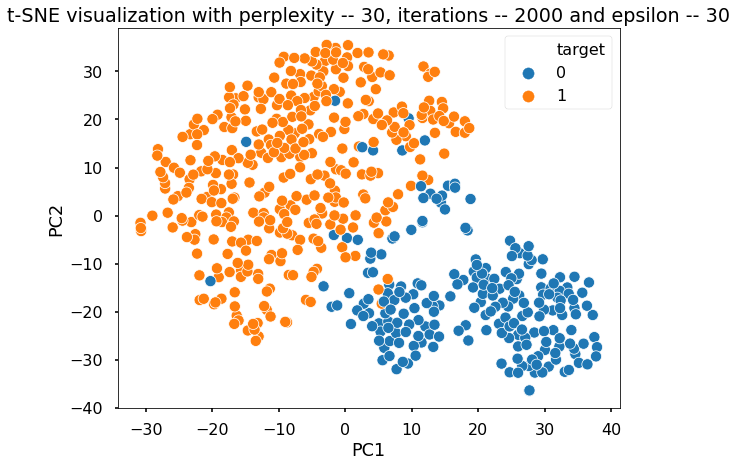

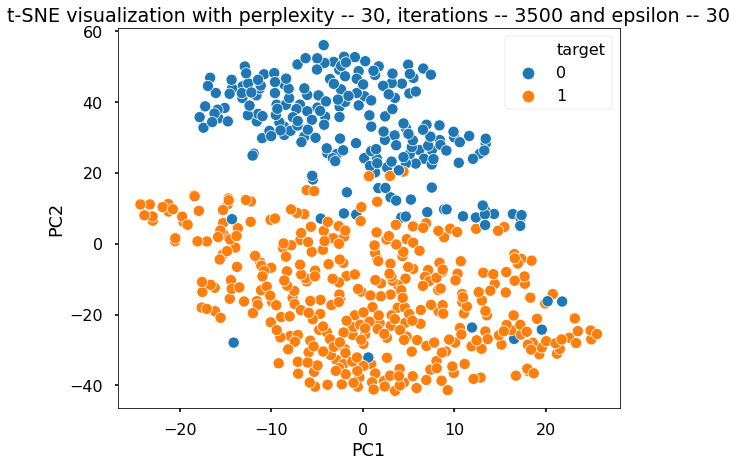

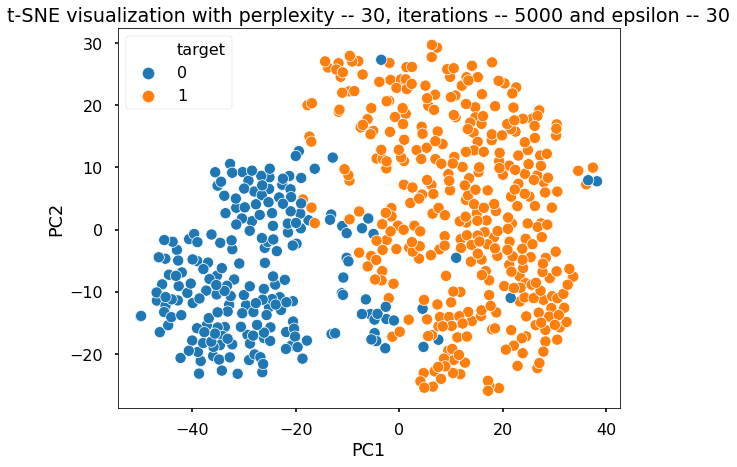

In [7]:
iterations = [250,500,750,1000,2000,3500,5000]

for idx in range(len(iterations)):
    tsne1 = TSNE(n_components=2,init='random',perplexity=30,learning_rate=30,n_iter=iterations[idx],
                 method='exact',
                 n_jobs=-1)
    cancer_tsne_pcmps = pd.DataFrame(tsne1.fit_transform(cancer_norm_df),columns=['PC1','PC2'])
    cancer_tsne_pcmps = pd.concat([cancer_tsne_pcmps,cancer_df['target']],axis=1)
    with plt.style.context('seaborn-poster'):
        plt.figure(figsize=(9,7))
        sns.scatterplot(data=cancer_tsne_pcmps,x='PC1',y='PC2',hue='target')
        plt.title("t-SNE visualization with perplexity -- {0}, iterations -- {1} and epsilon -- {2}".format(tsne1.perplexity,
                                                                                                            tsne1.n_iter,
                                                                                                            tsne1.learning_rate))
        plt.show()

## ***`CASE-III-Multiple_runs`***
### ***`Running t-SNE for a range of iterations with learning rate and perplexity as 30 and embedding method as 'PCA'`***

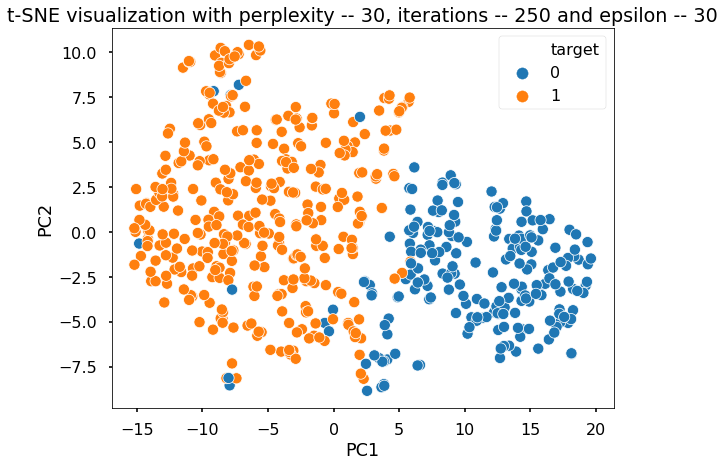

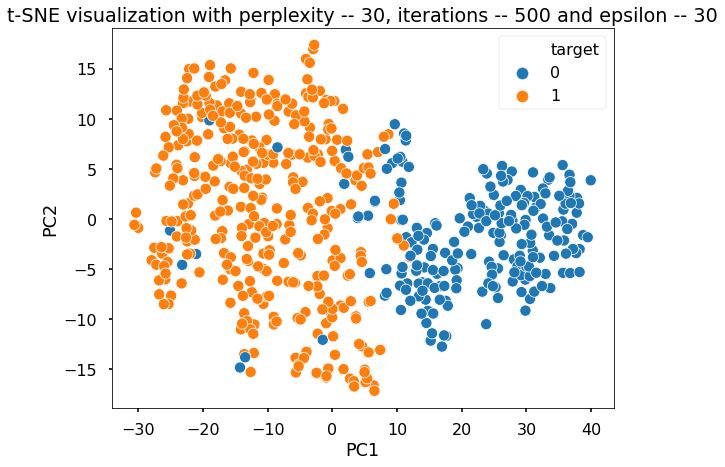

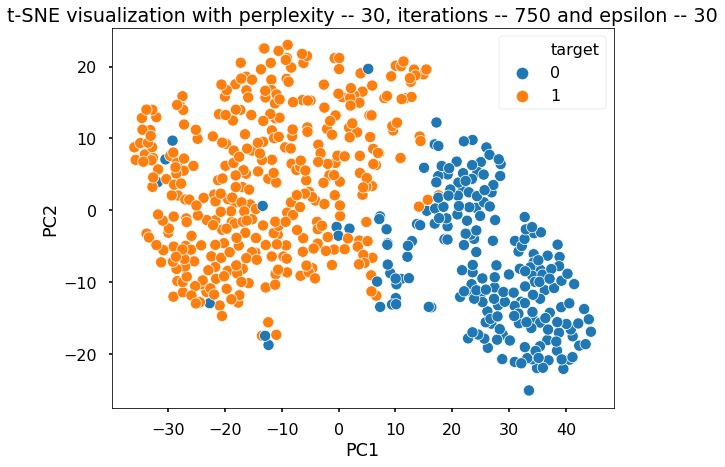

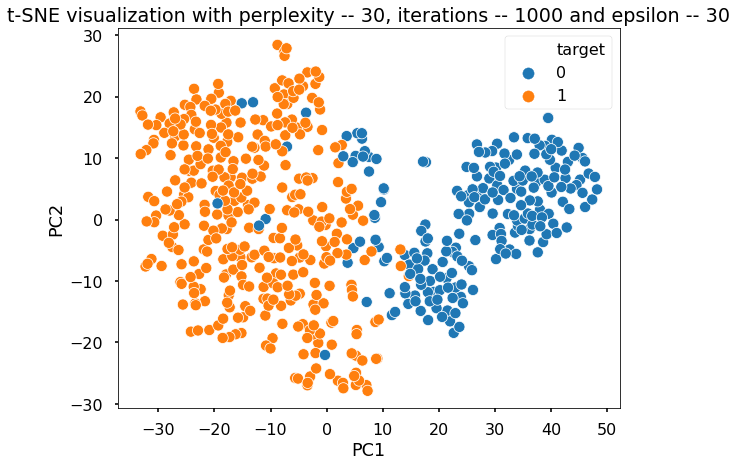

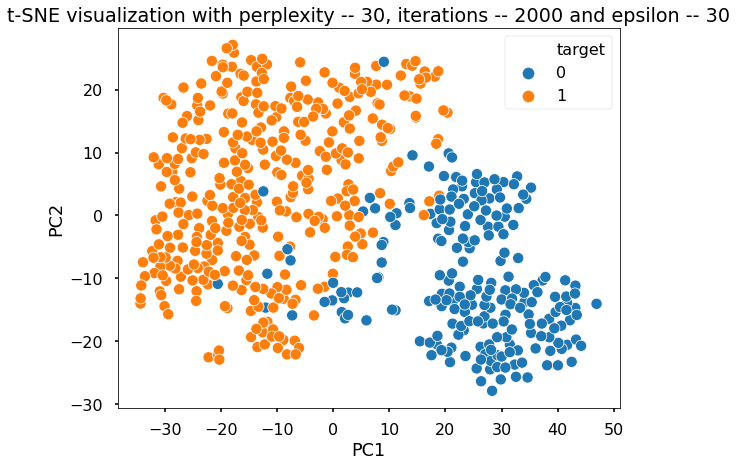

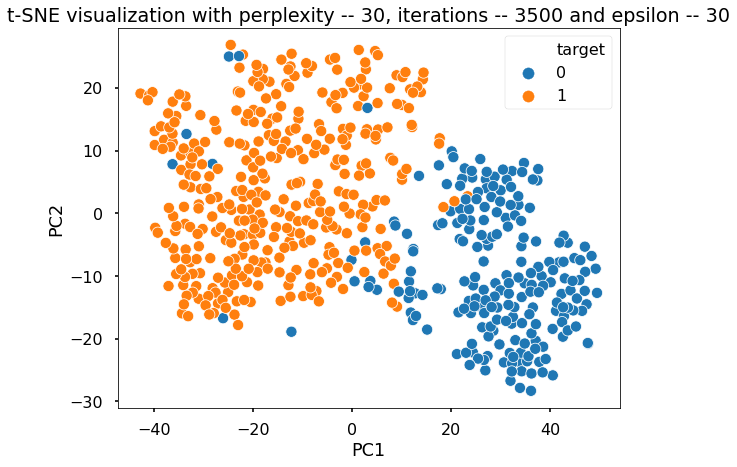

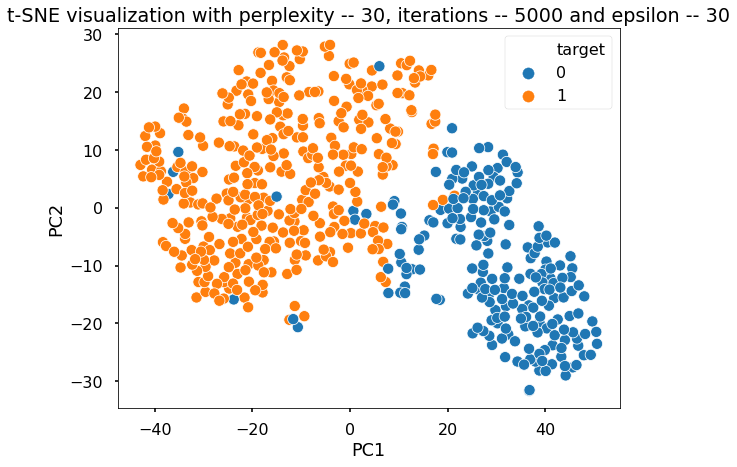

In [8]:
iterations = [250,500,750,1000,2000,3500,5000]

for idx in range(len(iterations)):
    tsne1 = TSNE(n_components=2,init='pca',perplexity=30,learning_rate=30,n_iter=iterations[idx],
                 method='exact',
                 n_jobs=-1)
    cancer_tsne_pcmps = pd.DataFrame(tsne1.fit_transform(cancer_norm_df),columns=['PC1','PC2'])
    cancer_tsne_pcmps = pd.concat([cancer_tsne_pcmps,cancer_df['target']],axis=1)
    with plt.style.context('seaborn-poster'):
        plt.figure(figsize=(9,7))
        sns.scatterplot(data=cancer_tsne_pcmps,x='PC1',y='PC2',hue='target')
        plt.title("t-SNE visualization with perplexity -- {0}, iterations -- {1} and epsilon -- {2}".format(tsne1.perplexity,
                                                                                                            tsne1.n_iter,
                                                                                                            tsne1.learning_rate))
        plt.show()

## ***`IRIS_Dataset`***

In [26]:
iris_df = pd.DataFrame(iris.data,columns=iris.feature_names)
iris_stand_df = pd.concat([pd.DataFrame(ss.fit_transform(iris_df),columns=iris.feature_names),
                           pd.DataFrame(iris.target,columns=['target'])],axis=1)
iris_stand_df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
0,-0.900681,1.019004,-1.340227,-1.315444,0
1,-1.143017,-0.131979,-1.340227,-1.315444,0
2,-1.385353,0.328414,-1.397064,-1.315444,0
3,-1.506521,0.098217,-1.283389,-1.315444,0
4,-1.021849,1.249201,-1.340227,-1.315444,0


In [37]:
class_label = {0:'iris-setosa',1:'iris-versicolor',2:'iris-virginica'}

In [38]:
iris_stand_df['target'] = iris_stand_df['target'].map(lambda row: class_label[row])

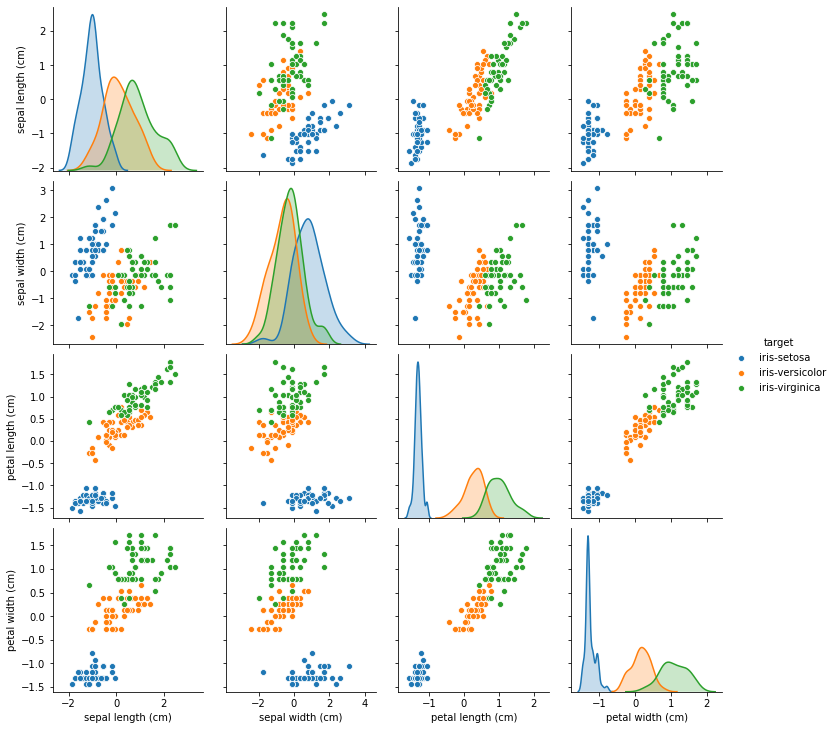

In [39]:
sns.pairplot(data=iris_stand_df,hue='target')

In [28]:
iris_stand_df.shape

(150, 5)

In [29]:
iris_stand_df.target.value_counts()

2    50
1    50
0    50
Name: target, dtype: int64

## ***`Multiple_runs`***

## ***`IRIS:CASE-I-Multiple_runs`***
### ***`Running t-SNE on a range of perplexities and iterations with fixed learning rate and embedding initialization as 'random'`***

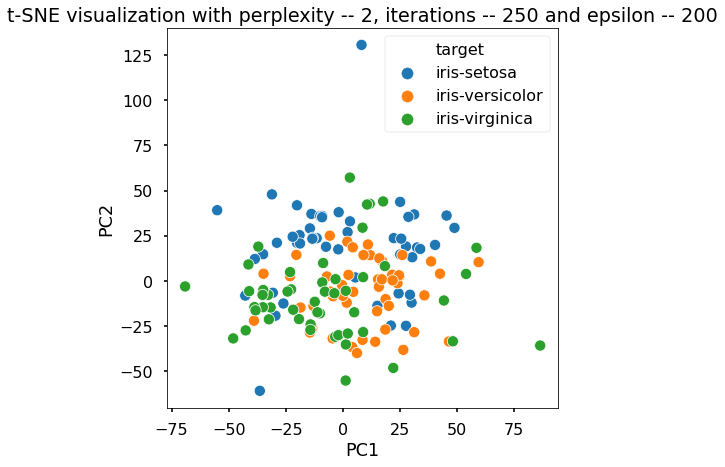

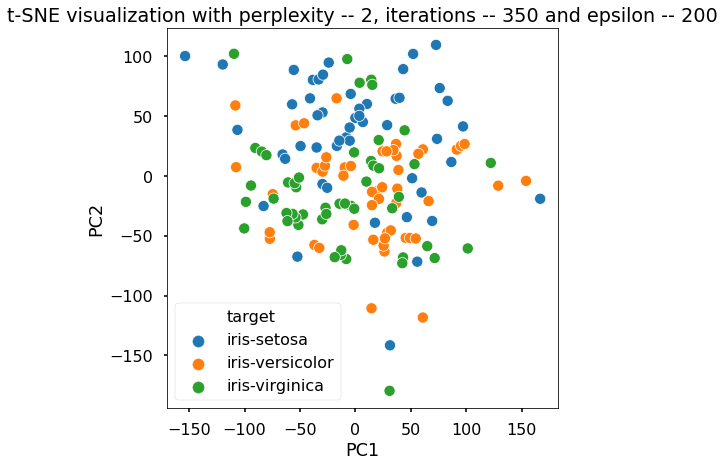

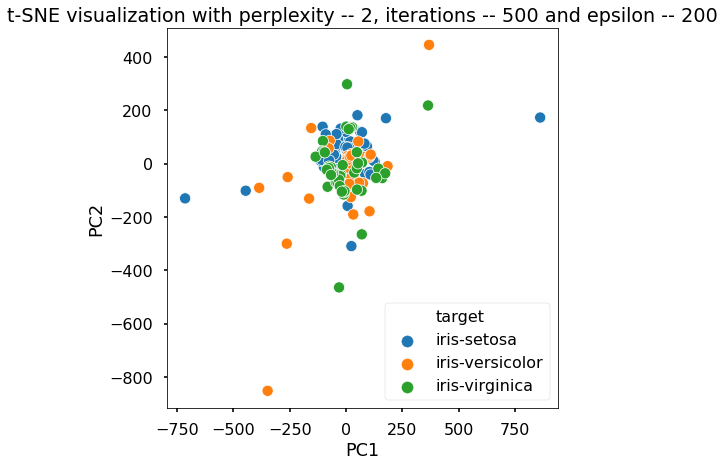

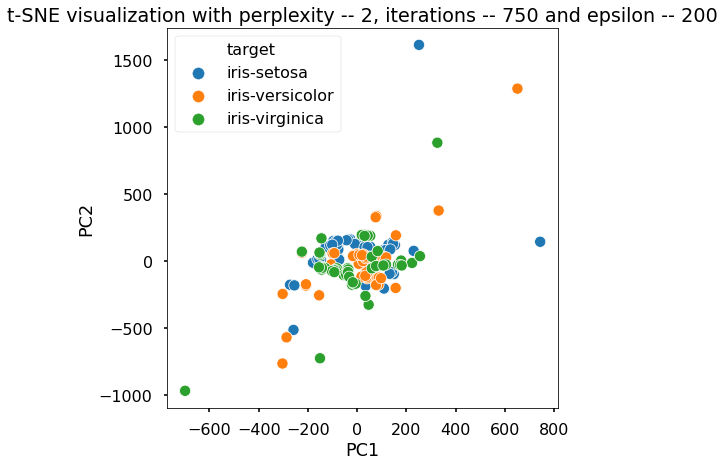

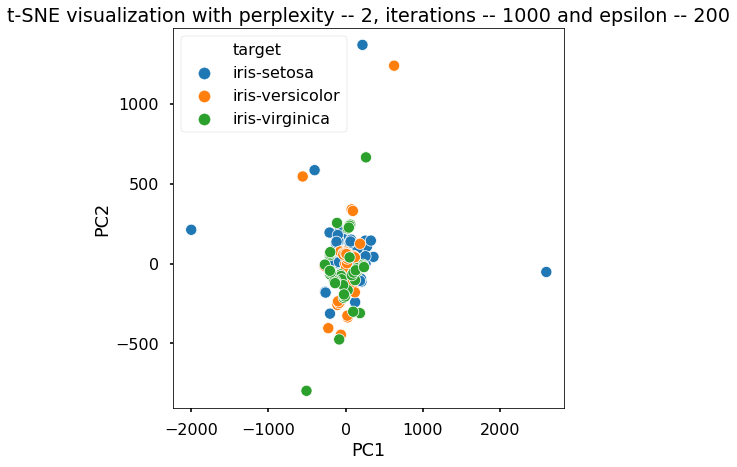

...

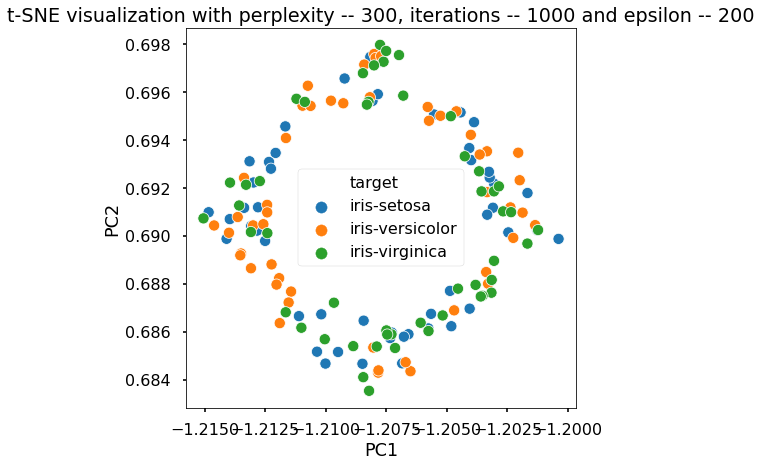

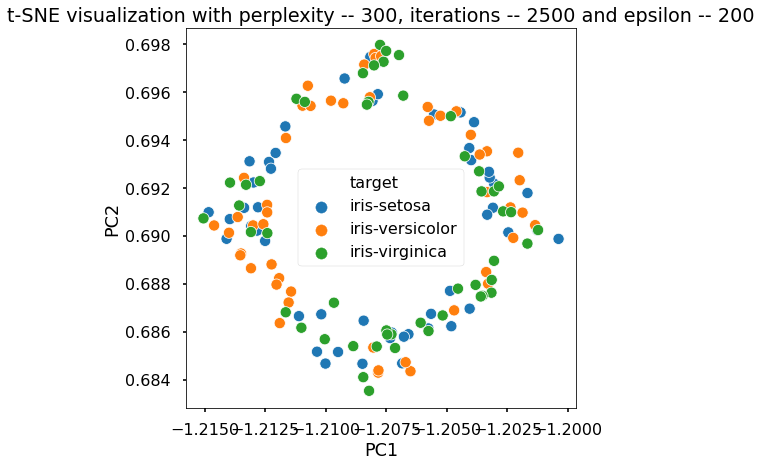

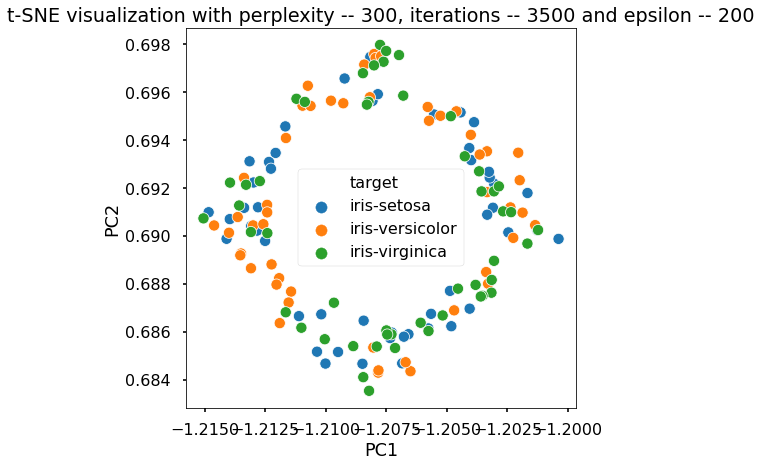

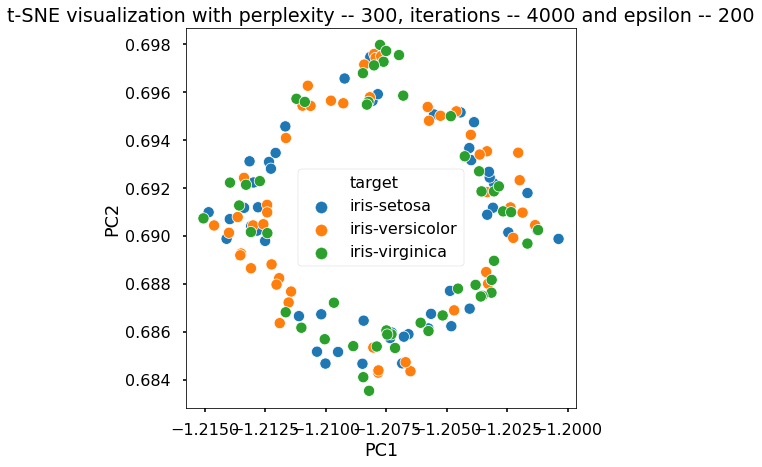

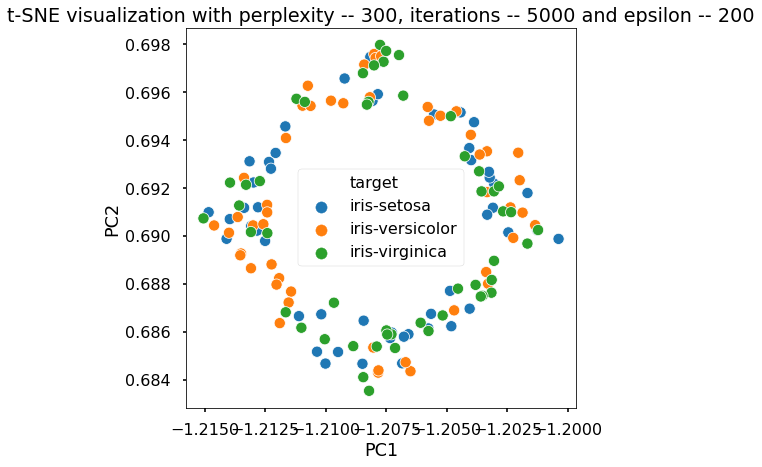

In [78]:
perplexities = [1,2,5,30,50,100,150]
iterations = [250,350,500,750,1000,2500,3500,4000,5000]

for pidx in range(len(perplexities)):
    for idx in range(len(iterations)):
        tsne_iris_1 = TSNE(n_components=2,perplexity=perplexities[pidx],learning_rate=200,n_iter=iterations[idx],
                           init='random',n_jobs=-1,random_state=23)
        iris1_tsne_pcmps = pd.DataFrame(tsne_iris_1.fit_transform(iris_stand_df.iloc[:,0:-1]),columns=['PC1','PC2'])
        iris1_tsne_pcmps = pd.concat([iris1_tsne_pcmps,iris_stand_df['target']],axis=1)
        with plt.style.context('seaborn-poster'):
            plt.figure(figsize=(7,7))
            sns.scatterplot(data=iris1_tsne_pcmps,x='PC1',y='PC2',hue='target')
            plt.title("t-SNE visualization with perplexity -- {0}, iterations -- {1} and epsilon -- {2}".format(tsne_iris_1.perplexity,
                                                                                                            tsne_iris_1.n_iter,
                                                                                                            tsne_iris_1.learning_rate))
            plt.show()

## ***`IRIS:CASE-II-Multiple_runs`***
### ***`Running t-SNE on a range of learning rates(epsilon) and iterations with fixed perplexity and embedding initialization as 'random'`***

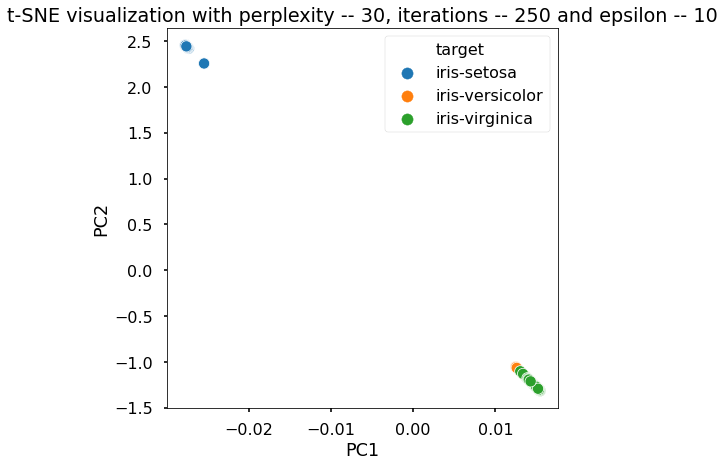

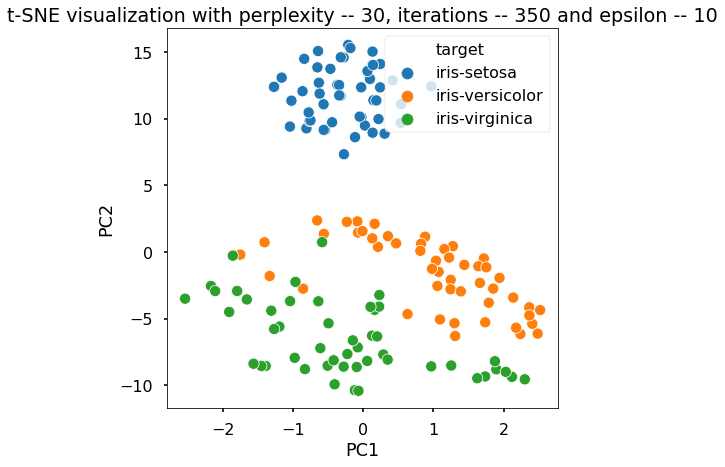

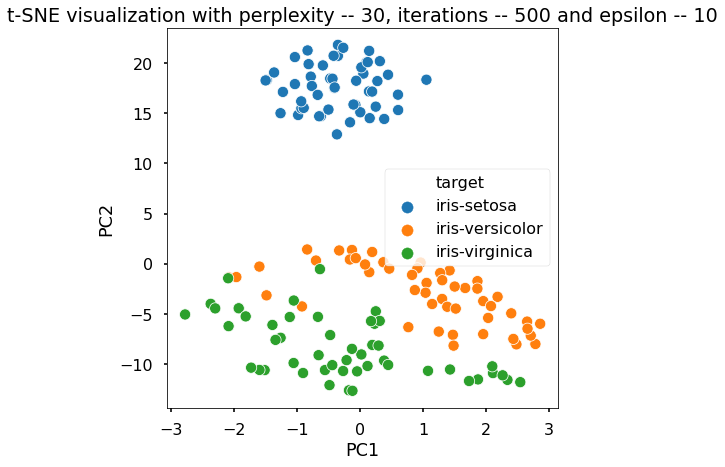

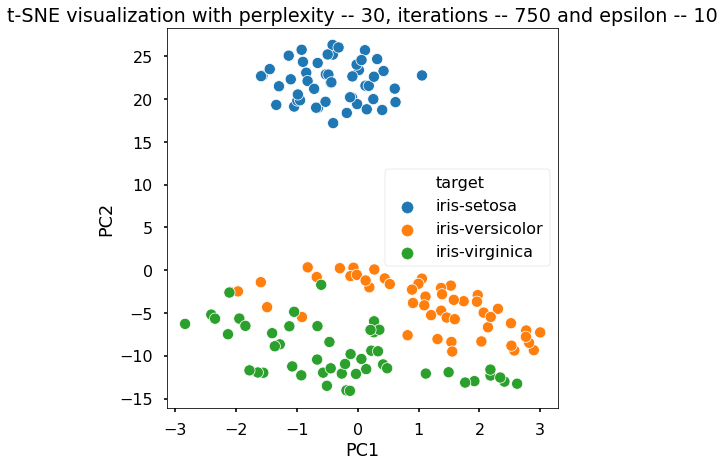

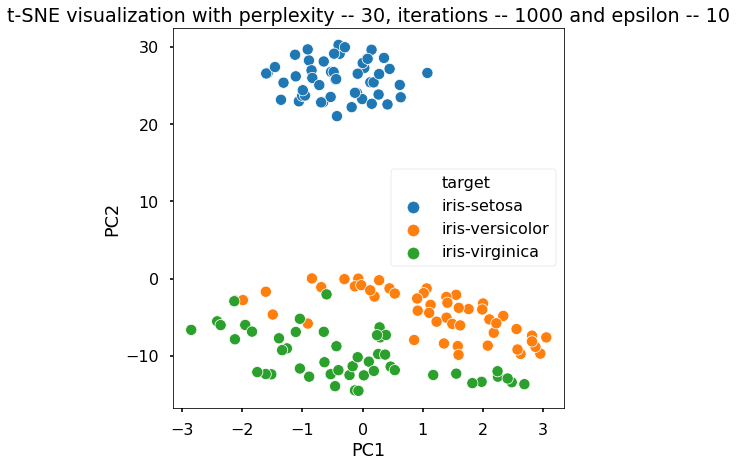

...

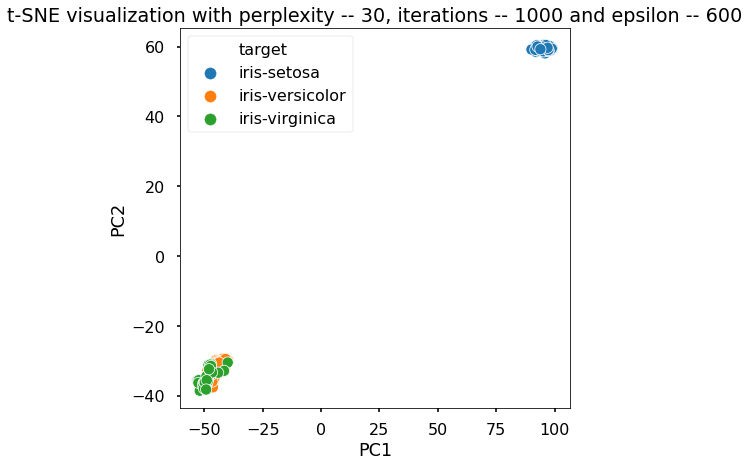

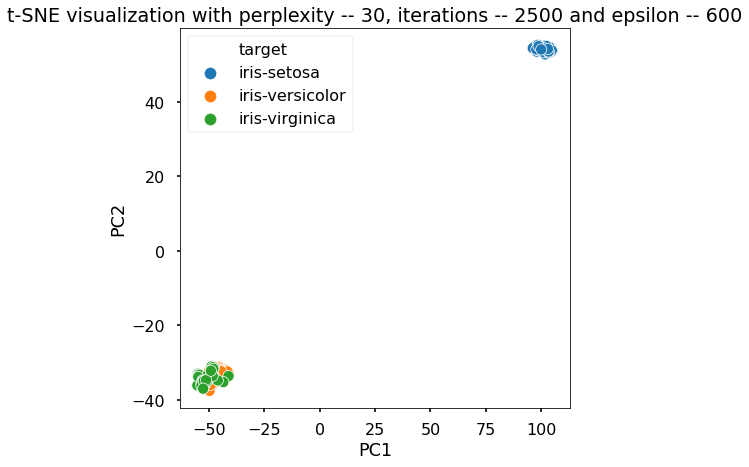

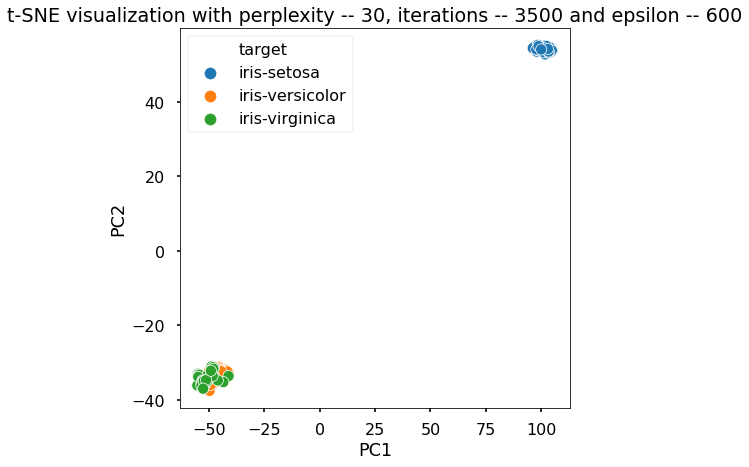

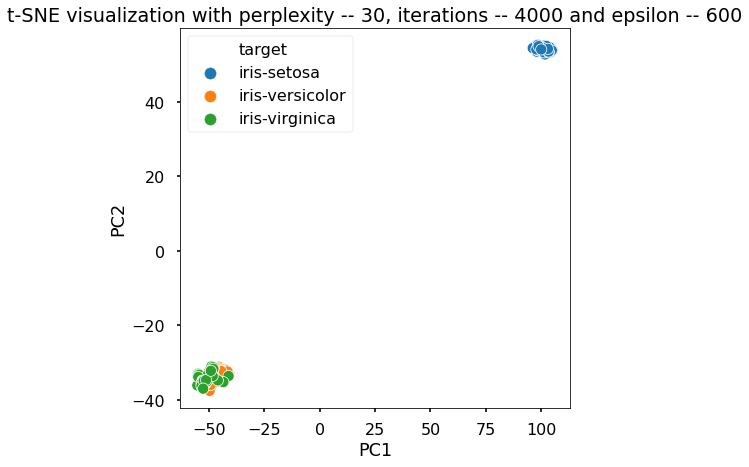

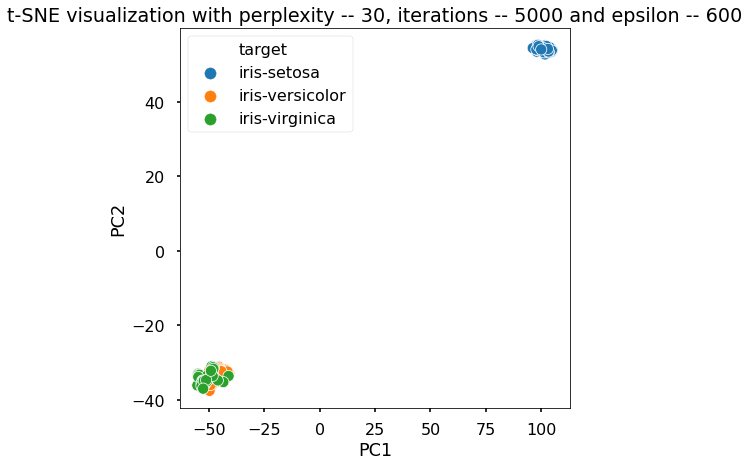

In [79]:
l_rate = [10,30,50,100,200,400,600]
iterations = [250,350,500,750,1000,2500,3500,4000,5000]

for lidx in range(len(l_rate)):
    for idx in range(len(iterations)):
        tsne_iris_1 = TSNE(n_components=2,perplexity=30,learning_rate=l_rate[lidx],n_iter=iterations[idx],
                           init='random',n_jobs=-1,random_state=23)
        iris1_tsne_pcmps = pd.DataFrame(tsne_iris_1.fit_transform(iris_stand_df.iloc[:,0:-1]),columns=['PC1','PC2'])
        iris1_tsne_pcmps = pd.concat([iris1_tsne_pcmps,iris_stand_df['target']],axis=1)
        with plt.style.context('seaborn-poster'):
            plt.figure(figsize=(7,7))
            sns.scatterplot(data=iris1_tsne_pcmps,x='PC1',y='PC2',hue='target')
            plt.title("t-SNE visualization with perplexity -- {0}, iterations -- {1} and epsilon -- {2}".format(tsne_iris_1.perplexity,
                                                                                                            tsne_iris_1.n_iter,
                                                                                                            tsne_iris_1.learning_rate))
            plt.show()

## ***`IRIS:CASE-III-Multiple_runs`***
### ***`Running t-SNE on a range of iterations of fixed perplexity and learning rate(epsilon) with embedding initialization as 'random'`***

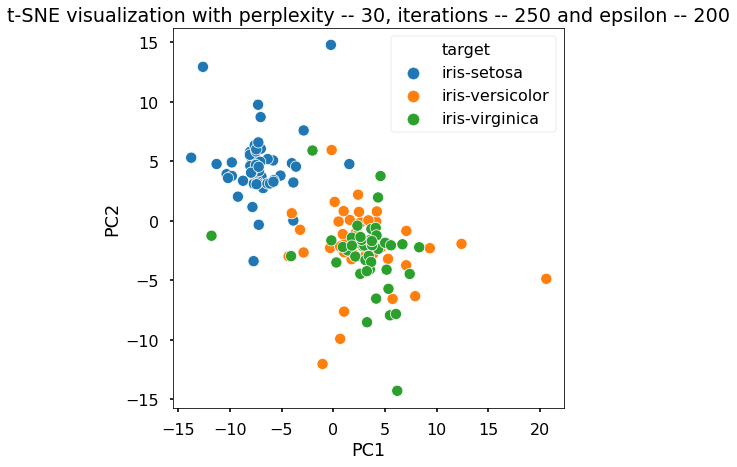

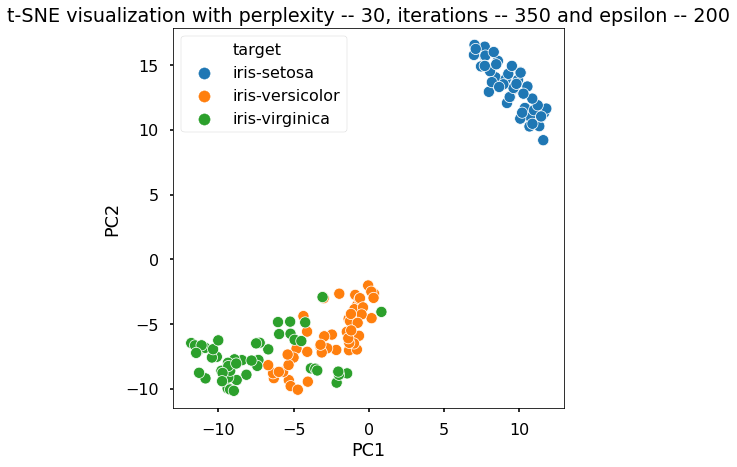

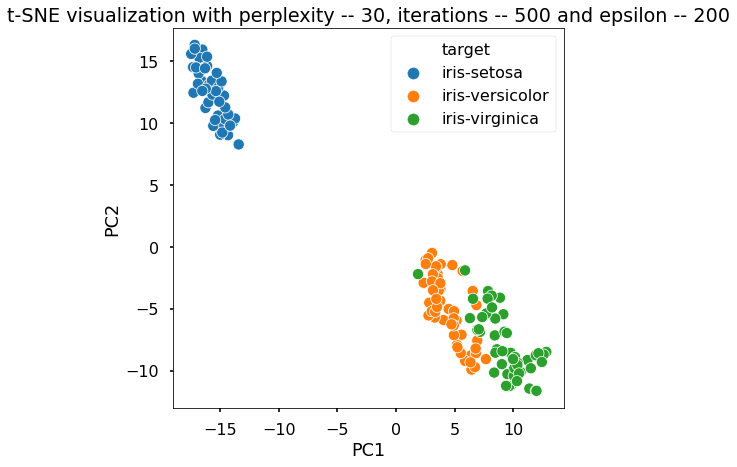

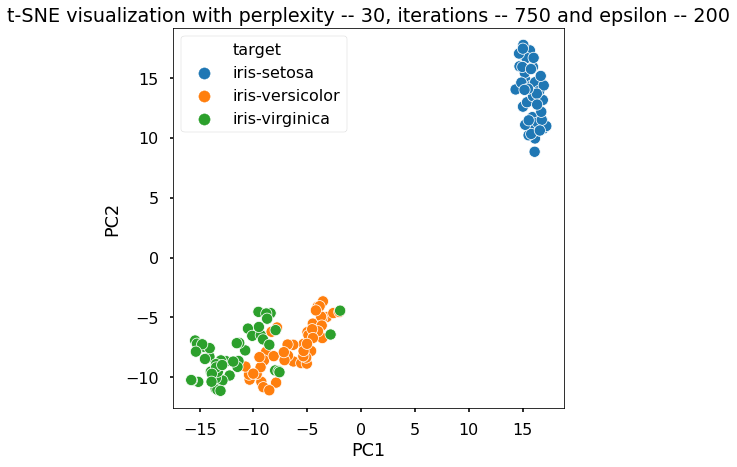

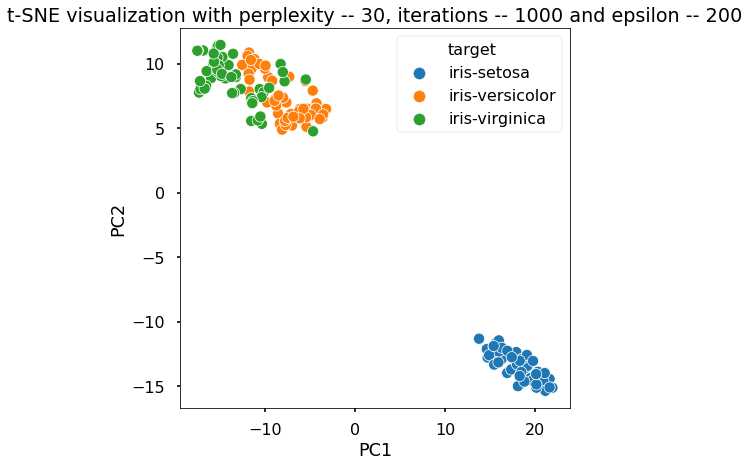

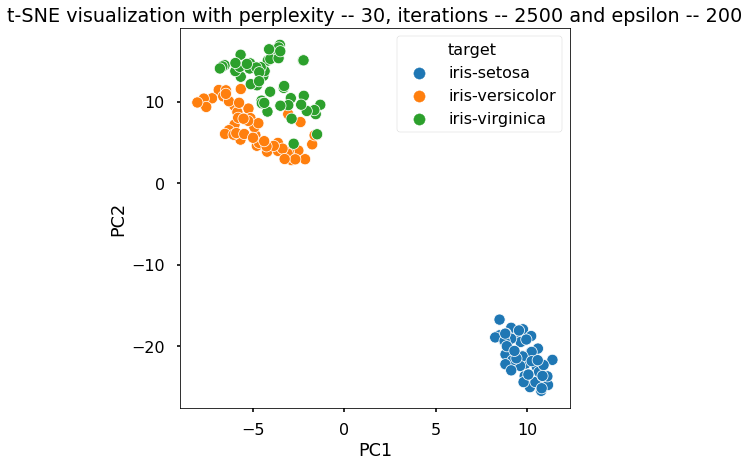

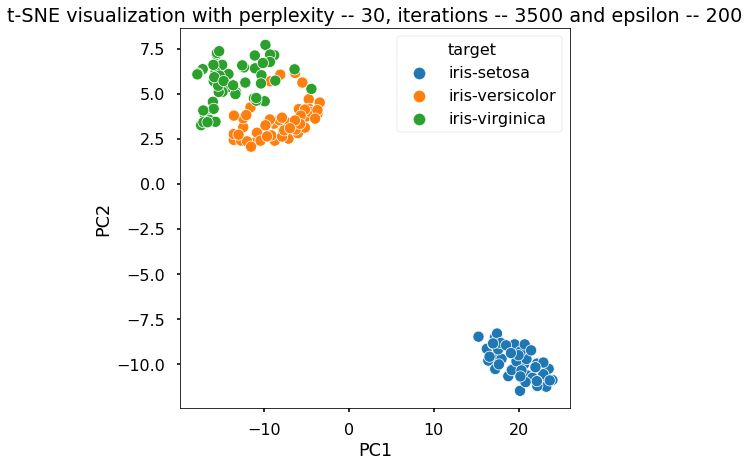

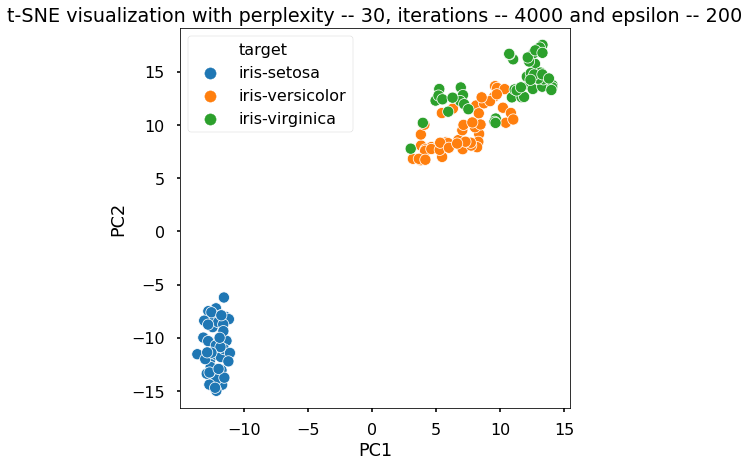

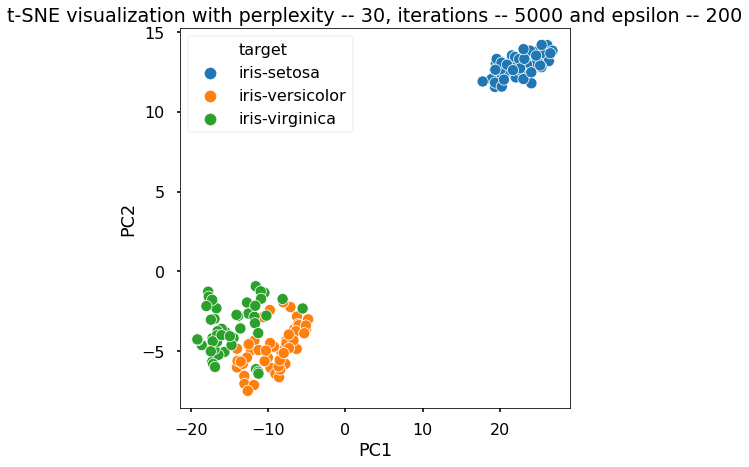

In [80]:
iterations = [250,350,500,750,1000,2500,3500,4000,5000]

for idx in range(len(iterations)):
    tsne_iris_1 = TSNE(n_components=2,perplexity=30,learning_rate=200,n_iter=iterations[idx],
                           init='random',n_jobs=-1)
    iris1_tsne_pcmps = pd.DataFrame(tsne_iris_1.fit_transform(iris_stand_df.iloc[:,0:-1]),columns=['PC1','PC2'])
    iris1_tsne_pcmps = pd.concat([iris1_tsne_pcmps,iris_stand_df['target']],axis=1)
    with plt.style.context('seaborn-poster'):
        plt.figure(figsize=(7,7))
        sns.scatterplot(data=iris1_tsne_pcmps,x='PC1',y='PC2',hue='target')
        plt.title("t-SNE visualization with perplexity -- {0}, iterations -- {1} and epsilon -- {2}".format(tsne_iris_1.perplexity,
                                                                                                            tsne_iris_1.n_iter,
                                                                                                            tsne_iris_1.learning_rate))
        plt.show()

### ***`IRIS:Result_of_multiple_runs`***

In [86]:
tsne_iris_1 = TSNE(n_components=2,perplexity=30,learning_rate=200,n_iter=5000,init='random',n_jobs=-1)

In [87]:
iris_tsne_cmps = pd.concat([pd.DataFrame(tsne_iris_1.fit_transform(iris_stand_df.iloc[:,0:-1]),columns=['PC1','PC2']),
                            pd.DataFrame(iris_stand_df.target,columns=['target'])],axis=1)
iris_tsne_cmps.head()

,PC1,PC2,target
0,-9.326900,-16.767998,iris-setosa
1,-9.125493,-13.043600,iris-setosa
2,-8.535302,-14.208212,iris-setosa
3,-8.310025,-13.506122,iris-setosa
4,-9.926417,-17.123808,iris-setosa


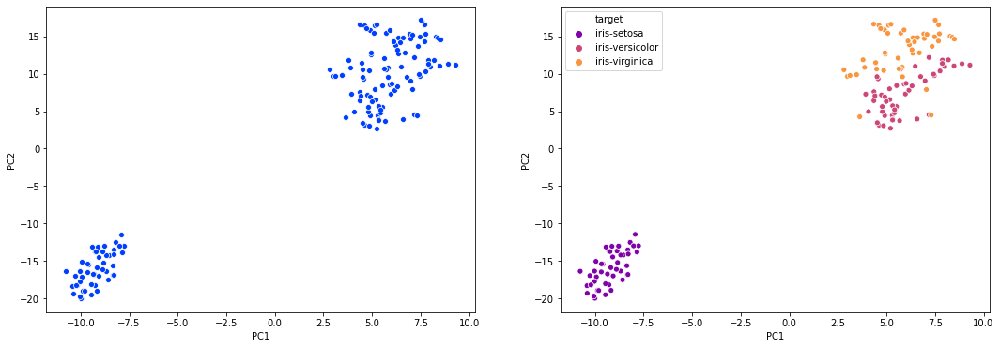

In [89]:
with plt.style.context('seaborn-bright'):
    fig,ax = plt.subplots(nrows=1,ncols=2,figsize=(18,6))
    sns.scatterplot(data=iris_tsne_cmps,x='PC1',y='PC2',ax=ax[0])
    sns.scatterplot(data=iris_tsne_cmps,x='PC1',y='PC2',hue='target',ax=ax[1],palette='plasma')

## ***`Other_method`***
### ***IRIS : t-SNE with 'pca' initialization embedding, Nearest neighbors error method as 'exact' and distance metric as 'minkowski'***

In [92]:
import scipy

tsne_iris_rand = TSNE(n_components=2,
                      perplexity=30,
                      learning_rate=200,
                      n_iter=5000,
                      init='pca',                 ## Good with the global capturing of structure of the data
                      method='exact',             ## This method is slower and not suitable for large data
                      metric=scipy.spatial.minkowski_distance,
                      n_jobs=-1)

In [93]:
iris_tsne_cmps = pd.concat([pd.DataFrame(tsne_iris_rand.fit_transform(iris_stand_df.iloc[:,0:-1]),columns=['PC1','PC2']),
                            pd.DataFrame(iris_stand_df.target,columns=['target'])],axis=1)
iris_tsne_cmps.head()

,PC1,PC2,target
0,-20.068819,12.580353,iris-setosa
1,-15.324358,10.337151,iris-setosa
2,-17.385283,9.968454,iris-setosa
3,-16.503378,9.369566,iris-setosa
4,-19.959255,13.517425,iris-setosa


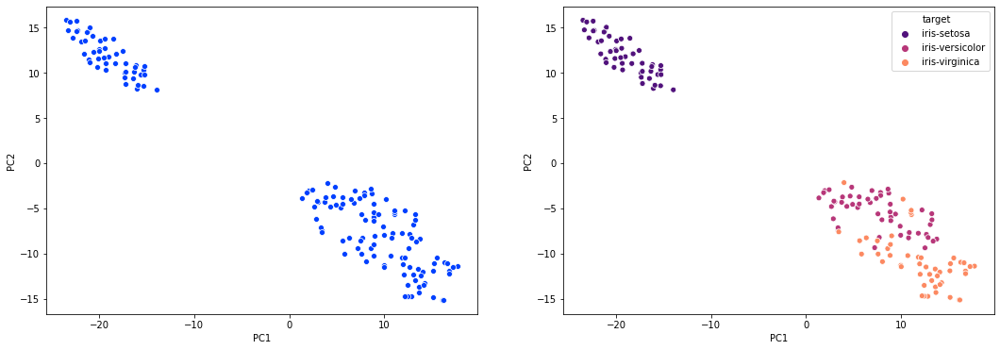

In [94]:
with plt.style.context('seaborn-bright'):
    fig,ax = plt.subplots(nrows=1,ncols=2,figsize=(18,6))
    sns.scatterplot(data=iris_tsne_cmps,x='PC1',y='PC2',ax=ax[0])
    sns.scatterplot(data=iris_tsne_cmps,x='PC1',y='PC2',hue='target',ax=ax[1],palette='magma')

# **`Conclusion`**

## **In my analysis with two different dataset I found that t-SNE gives better results when embedding method is 'PCA' inplace of 'random' and nearest neighbors error method as 'exact' instead of 'barnes_hut'.**

## **The 'barnes_hut' method is much better in terms of execution performance as compared to 'exact' and it is not a good approach with a large dataset. If you want the nearest neighbors error to be less than 3% and your dataset is not very large then better go with 'exact'.**